In [1]:
!pip3 install pytorch_msssim

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 3.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 33.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 26.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 28.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 9.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 4.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 6.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 21.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling nvidia-nvjitlink-cu12-12.5.82:
      Successfully uninstalled nvidia-nvjitlink

In [28]:
# Necessary imports

# Attach the drive
from google.colab import drive
drive.mount('/content/drive')

# Necessary imports

import zipfile
import os
from astropy.io import fits
from scipy.stats import entropy, pearsonr
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sb
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from scipy.stats import pearsonr
from IPython.display import Image, display
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, DBSCAN, AgglomerativeClustering
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import train_test_split
import torch
import torch.nn as nn
import torch.nn.functional as F
import random
import umap.umap_ as umap
import warnings
from torchvision.models import alexnet
import matplotlib.pyplot as plt
from IPython.display import SVG, display
from tensorflow.keras.utils import plot_model
from pytorch_msssim import ms_ssim
from scipy.ndimage import gaussian_filter

warnings.filterwarnings("ignore")


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [6]:
# Chk the directory
os.chdir("/content/drive")
print(os.getcwd())

/content/drive


In [8]:
# Its a zip file which has the samples, unzip it

"""
NOTE : replace the path with your system's / drive's
"""

file_src="/content/DATASET_EXXA.zip"

unzip_file_dest="/content/DATASET_EXXA/"


with zipfile.ZipFile(file_src,"r") as filesr:

  filesr.extractall(unzip_file_dest)

# Change the directory
os.chdir("/content/DATASET_EXXA/")

# Take a random file and display its structure ( will be same as depicted above)
sample_file="planet89_00294_1250.fits"
hdu=fits.open(sample_file)
print(hdu.info())

Filename: planet89_00294_1250.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      27   (600, 600, 1, 1, 4)   float32   
  1                1 ImageHDU        10   (1, 1, 1, 2)   float32   
  2                1 ImageHDU         9   (1, 1, 1)   float32   
  3                1 ImageHDU         8   (3, 1)   float32   
None


In [9]:
pwd = os.getcwd()
print(pwd)

/content/DATASET_EXXA


In [10]:
# Store the necessary ones in a list
# Remove the singleton dimensions , our final dimensions of a sample will be (600,600,4)
primaryDataList = []

for file in sorted(os.listdir(pwd)):
    if file.endswith(".fits"):
        hdu = fits.open(os.path.join(pwd, file))
        data = hdu[0].data  # shape: (1, 1, 4, 600, 600)
        # print("data shape ",data.shape)
        hdu.close()

        image = np.squeeze(data)  # shape: (4, 600, 600)
        image = np.transpose(image, (1, 2, 0))  # shape: (600, 600, 4)
        # print(image.shape)

        primaryDataList.append(image)


In [11]:
# Check for any image corruptions like having nans or infs in between
for i in range(len(primaryDataList)):
  img=primaryDataList[i]
  if np.isnan(img).any() or np.isinf(img).any():
    print(f"####### Corruption at img no {i} ############################33")
  else:
    primaryDataList[i]=primaryDataList[i].astype(np.float32)
    print(f"img { i} clear!!!")

img 0 clear!!!
img 1 clear!!!
img 2 clear!!!
img 3 clear!!!
img 4 clear!!!
img 5 clear!!!
img 6 clear!!!
img 7 clear!!!
img 8 clear!!!
img 9 clear!!!
img 10 clear!!!
img 11 clear!!!
img 12 clear!!!
img 13 clear!!!
img 14 clear!!!
img 15 clear!!!
img 16 clear!!!
img 17 clear!!!
img 18 clear!!!
img 19 clear!!!
img 20 clear!!!
img 21 clear!!!
img 22 clear!!!
img 23 clear!!!
img 24 clear!!!
img 25 clear!!!
img 26 clear!!!
img 27 clear!!!
img 28 clear!!!
img 29 clear!!!
img 30 clear!!!
img 31 clear!!!
img 32 clear!!!
img 33 clear!!!
img 34 clear!!!
img 35 clear!!!
img 36 clear!!!
img 37 clear!!!
img 38 clear!!!
img 39 clear!!!
img 40 clear!!!
img 41 clear!!!
img 42 clear!!!
img 43 clear!!!
img 44 clear!!!
img 45 clear!!!
img 46 clear!!!
img 47 clear!!!
img 48 clear!!!
img 49 clear!!!
img 50 clear!!!
img 51 clear!!!
img 52 clear!!!
img 53 clear!!!
img 54 clear!!!
img 55 clear!!!
img 56 clear!!!
img 57 clear!!!
img 58 clear!!!
img 59 clear!!!
img 60 clear!!!
img 61 clear!!!
img 62 clear!!!
im

In [12]:
def normalise_img(image):

  imgMax=np.max(image)
  imgMin=np.min(image)

  if imgMax-imgMin>0:
    return (image-imgMin)/(imgMax-imgMin)
  else:
    return np.zeros_like(image)

def normalise_per_band(image):

  for band in range(image.shape[2]):
    band_max=np.max(image[:,:,band])
    band_min=np.min(image[:,:,band])
    if band_max-band_min>0:
      image[:,:,band]=(image[:,:,band]-band_min)/(band_max-band_min)
    else:
      image[:,:,band]=np.zeros_like(image[:,:,band])

  return image

def standardise_per_band(image):

  for band in range(image.shape[2]):
    band_mean=np.mean(image[:,:,band])
    band_std=np.std(image[:,:,band])
    if band_std>0:
      image[:,:,band]=(image[:,:,band]-band_mean)/band_std
    else:
      image[:,:,band]=np.zeros_like(image[:,:,band])

  return image


normalised=[]
normalised2=[]
standardised=[]

for image in primaryDataList:
  normalised.append(normalise_img(image))

for image in primaryDataList:
  normalised2.append(normalise_per_band(image))

for image in primaryDataList:
  standardised.append(standardise_per_band(image))



(600, 600, 4)


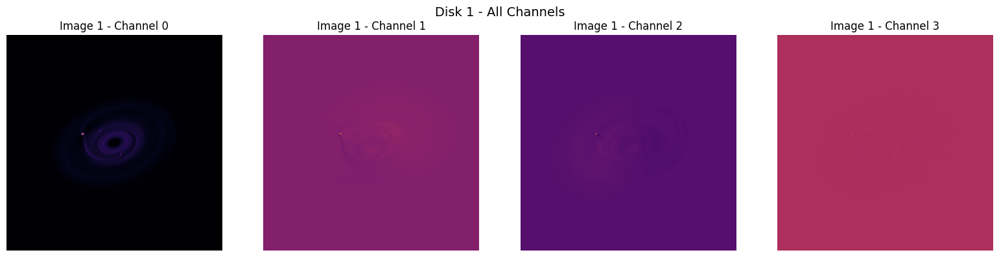

(600, 600, 4)


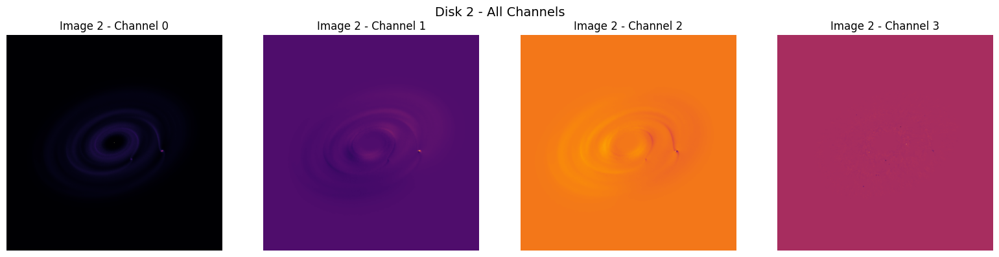

(600, 600, 4)


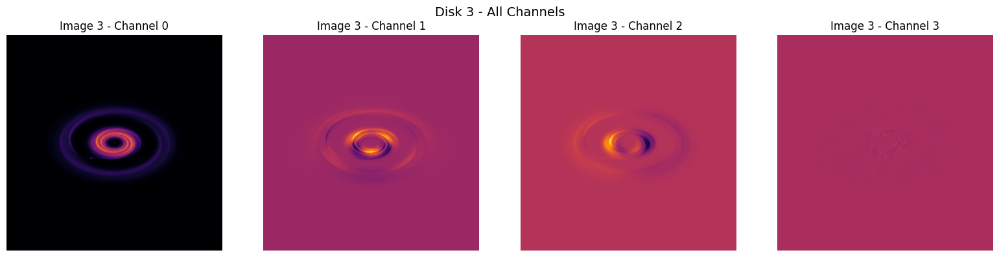

(600, 600, 4)


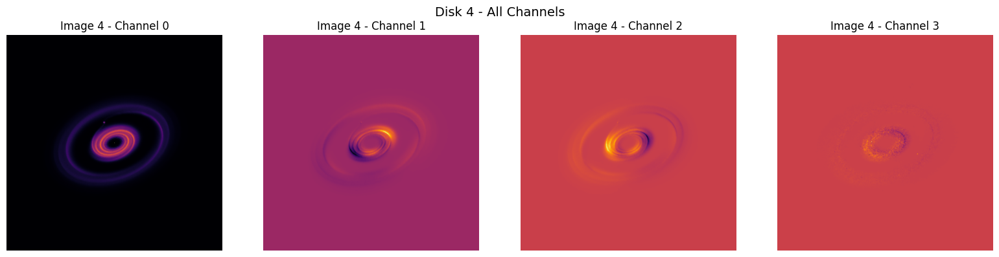

(600, 600, 4)


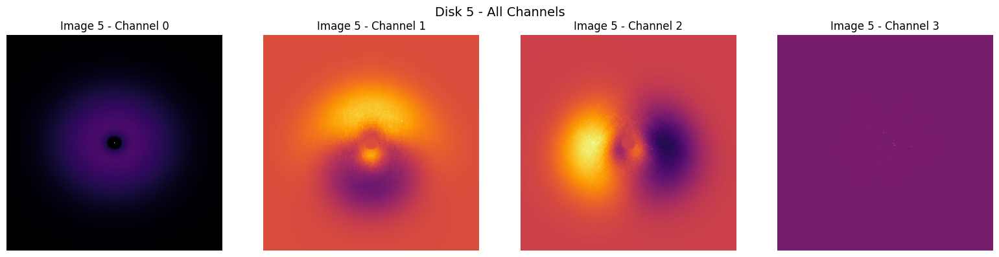

(600, 600, 4)


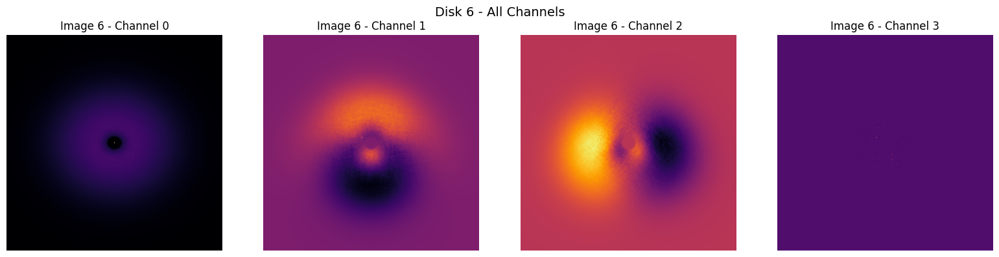

(600, 600, 4)


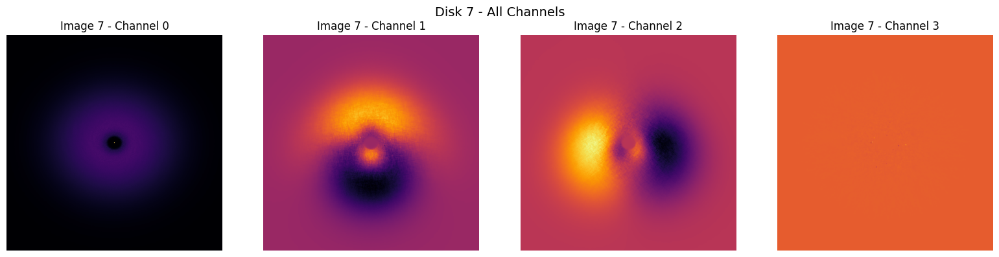

(600, 600, 4)


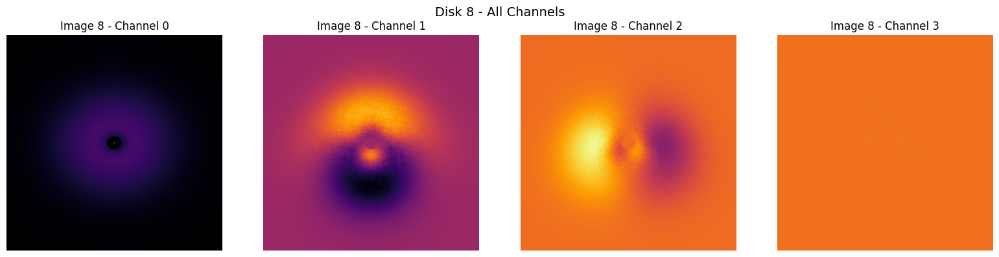

(600, 600, 4)


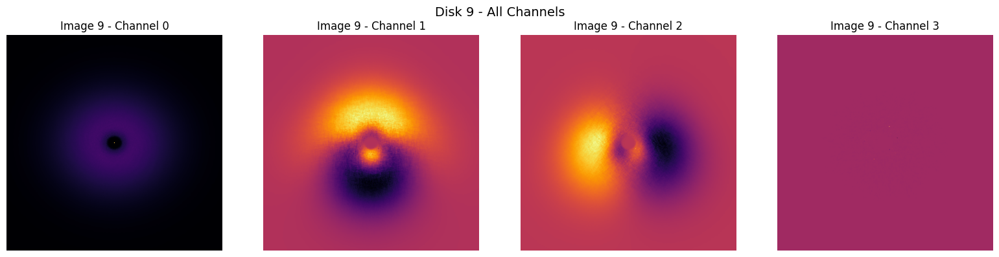

(600, 600, 4)


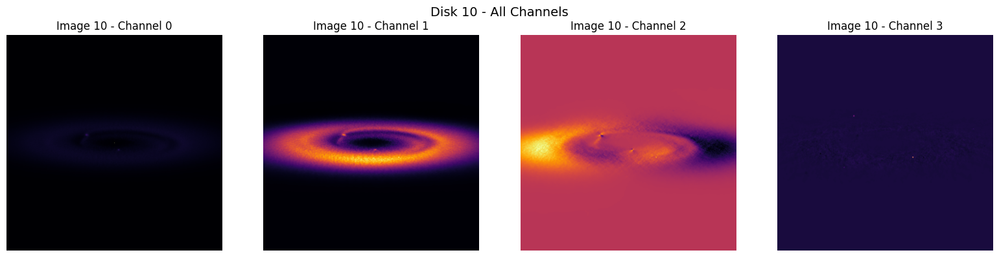

(600, 600, 4)


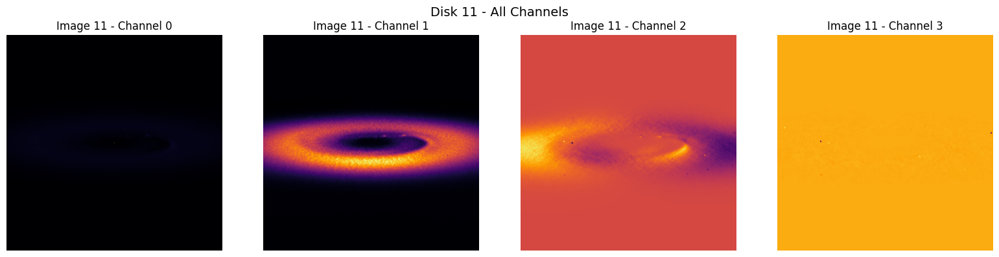

(600, 600, 4)


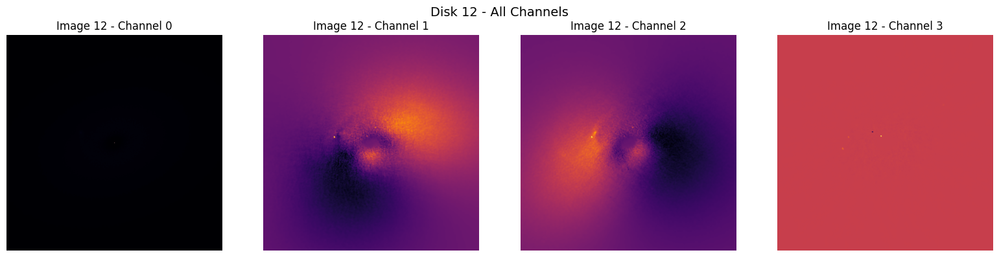

(600, 600, 4)


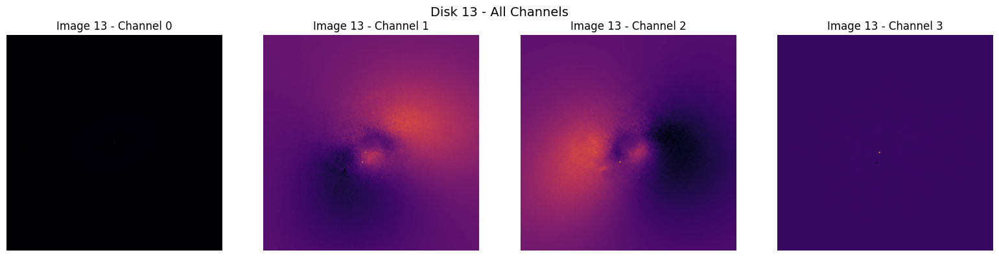

(600, 600, 4)


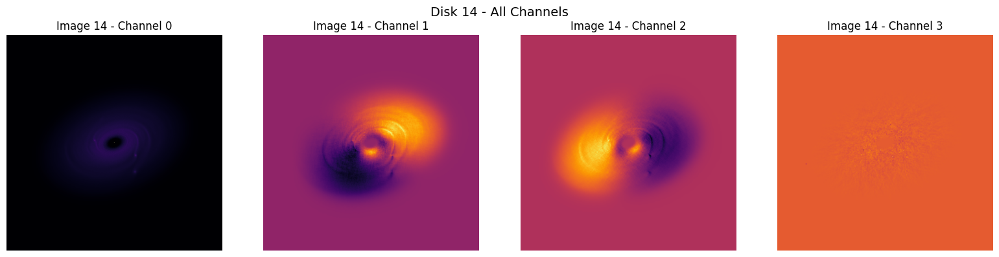

(600, 600, 4)


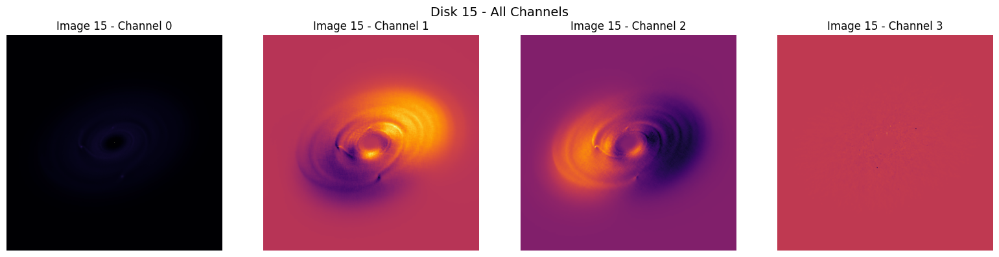

(600, 600, 4)


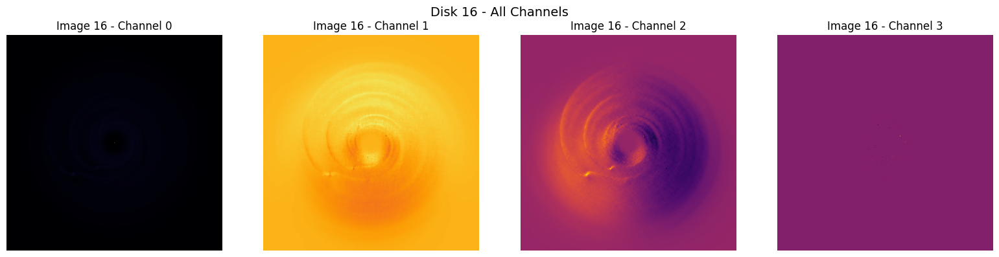

(600, 600, 4)


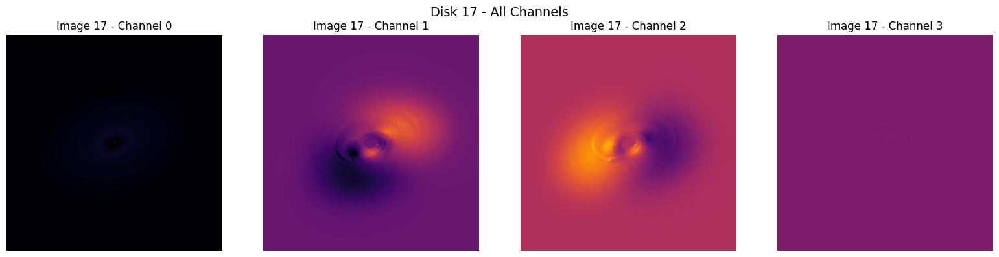

(600, 600, 4)


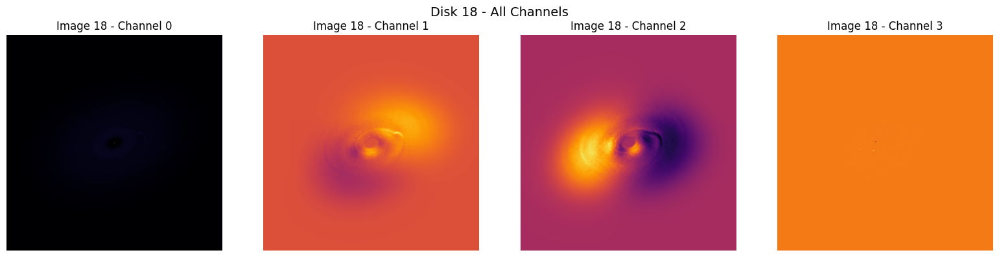

(600, 600, 4)


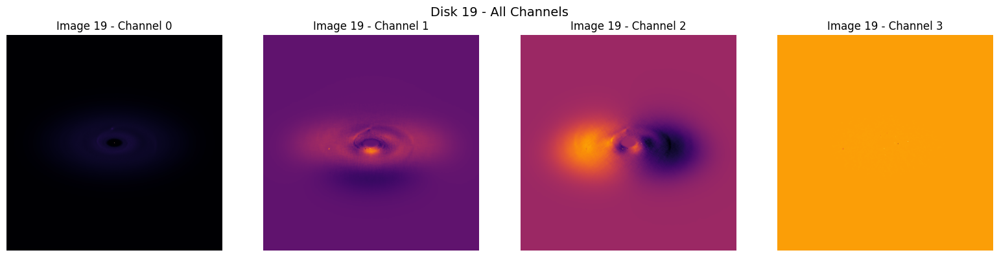

(600, 600, 4)


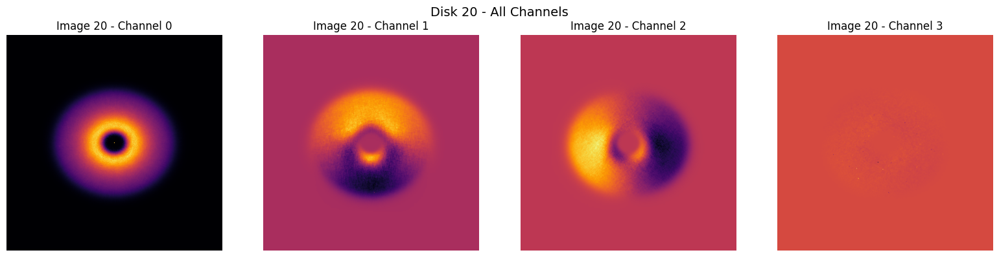

(600, 600, 4)


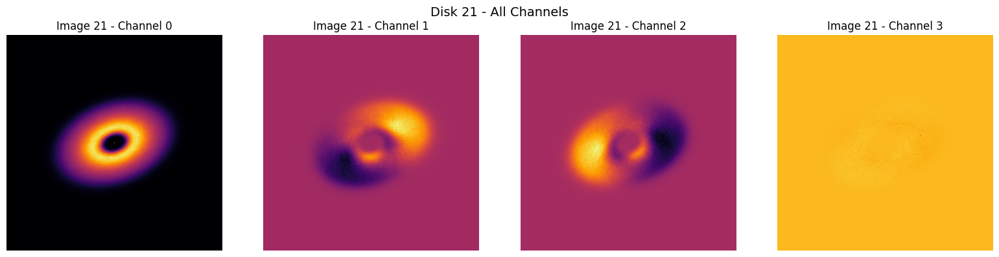

(600, 600, 4)


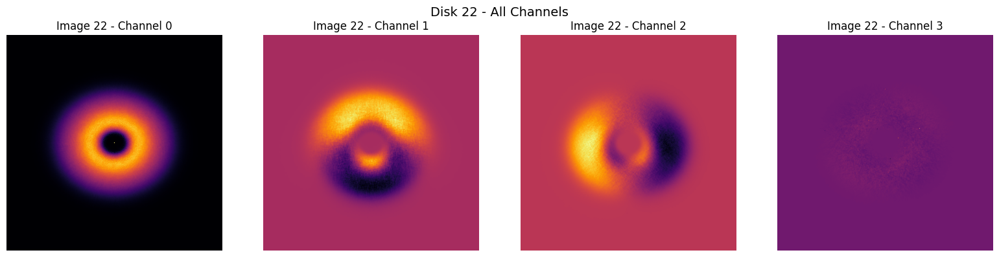

(600, 600, 4)


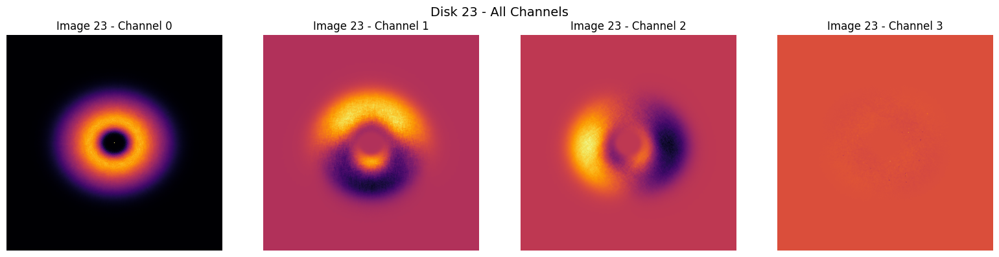

(600, 600, 4)


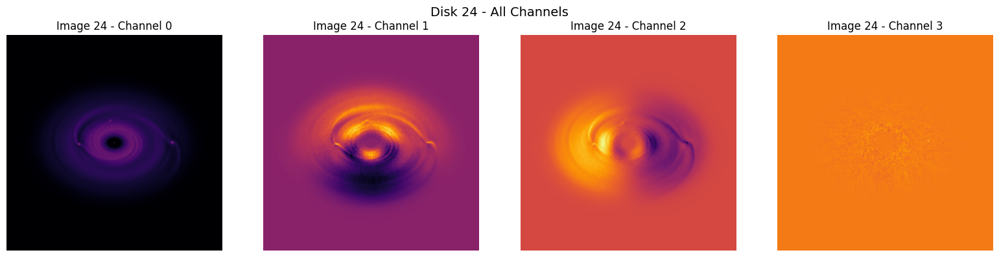

(600, 600, 4)


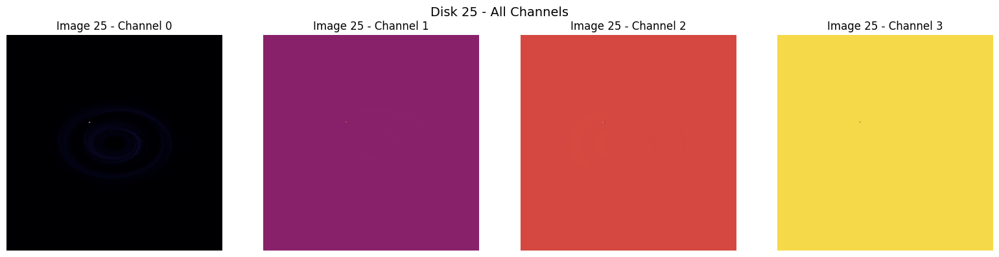

(600, 600, 4)


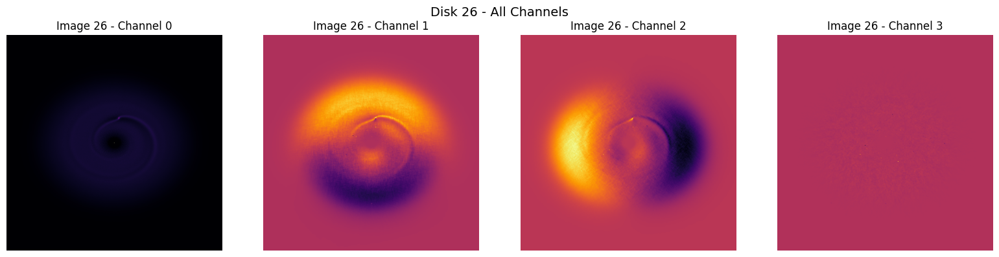

(600, 600, 4)


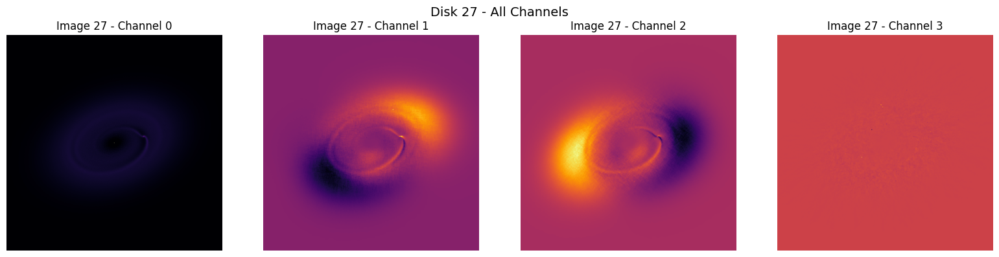

(600, 600, 4)


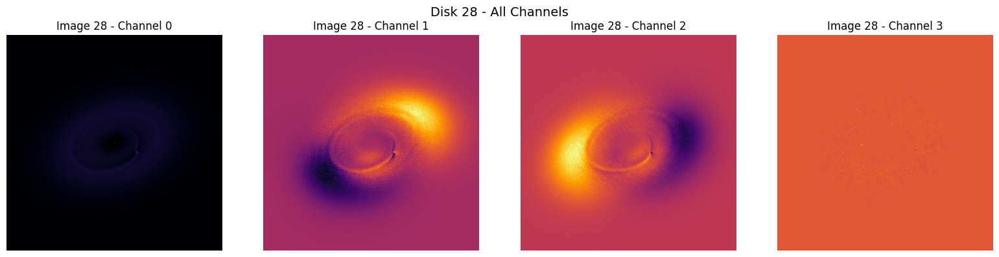

(600, 600, 4)


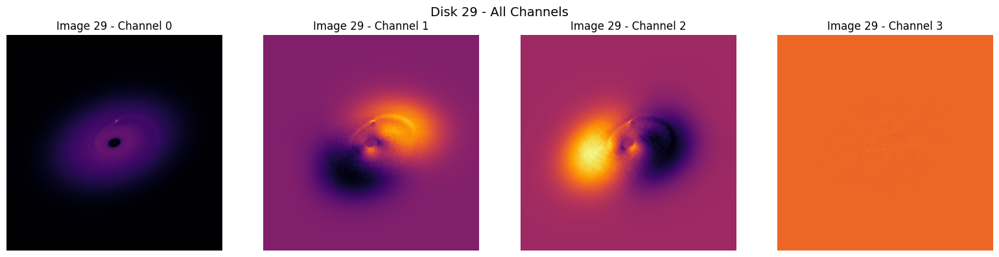

(600, 600, 4)


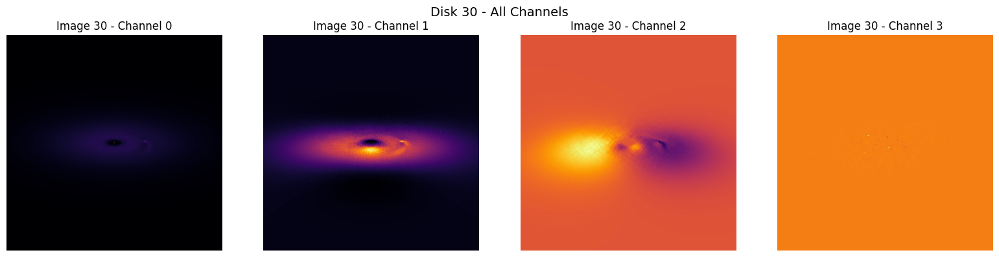

(600, 600, 4)


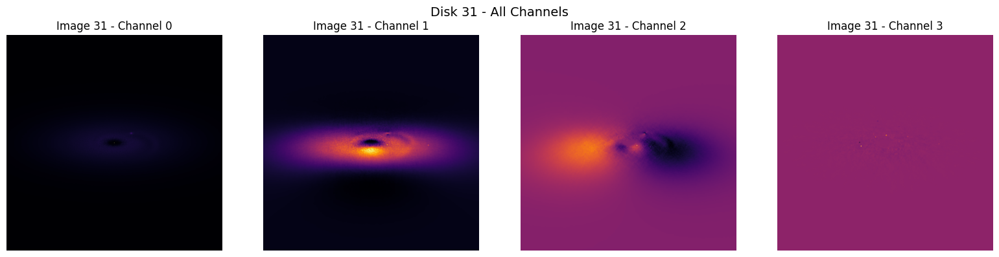

(600, 600, 4)


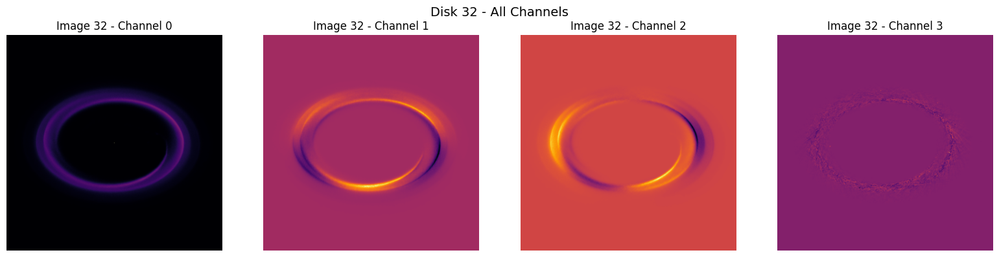

(600, 600, 4)


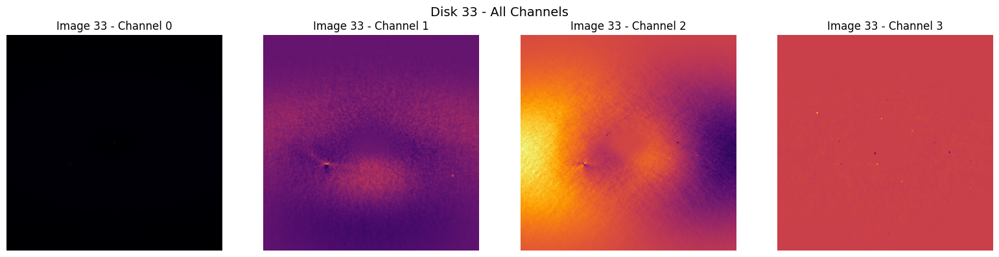

(600, 600, 4)


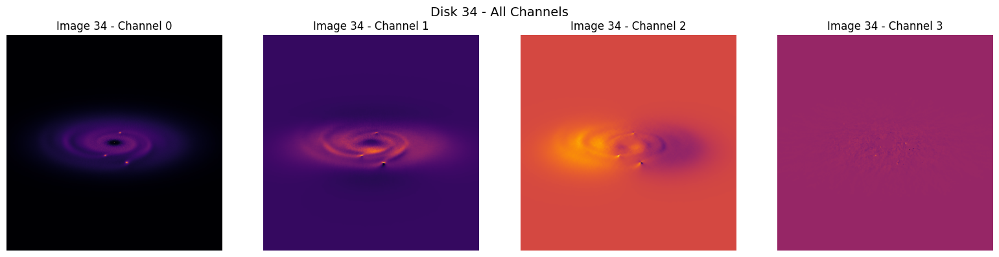

(600, 600, 4)


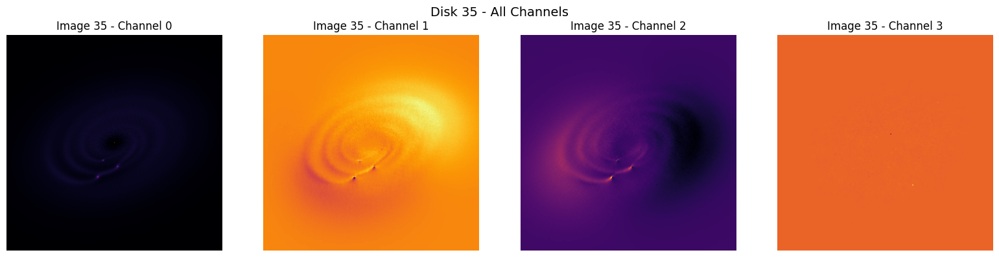

(600, 600, 4)


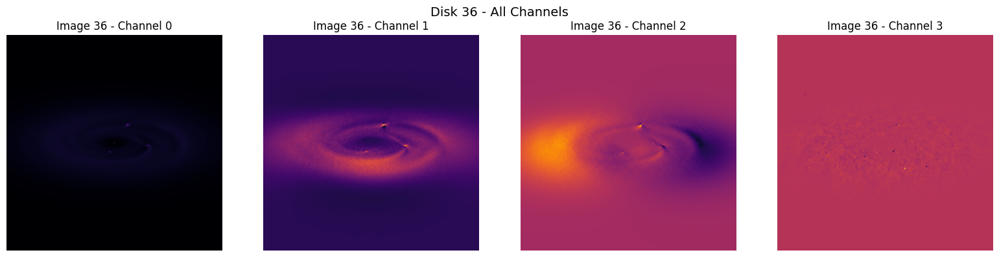

(600, 600, 4)


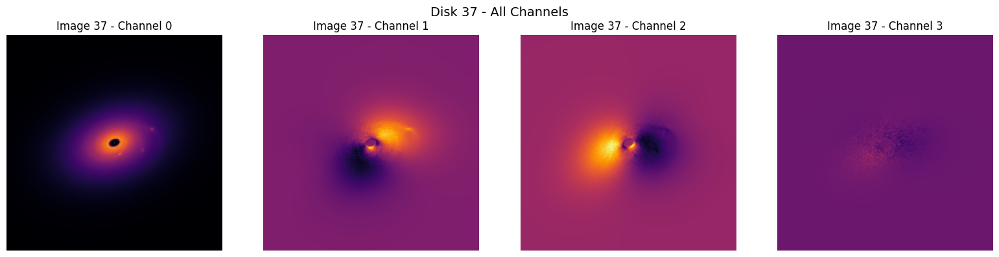

(600, 600, 4)


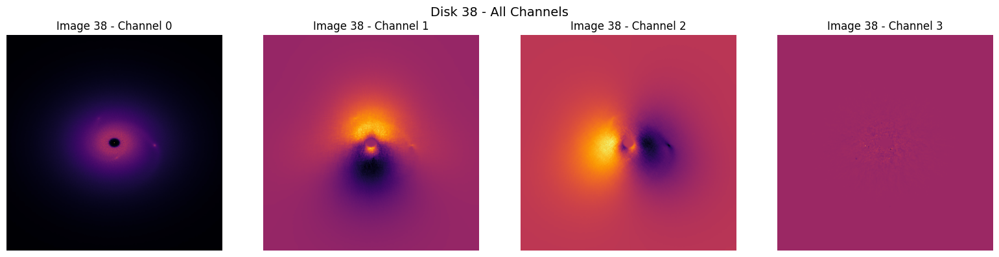

(600, 600, 4)


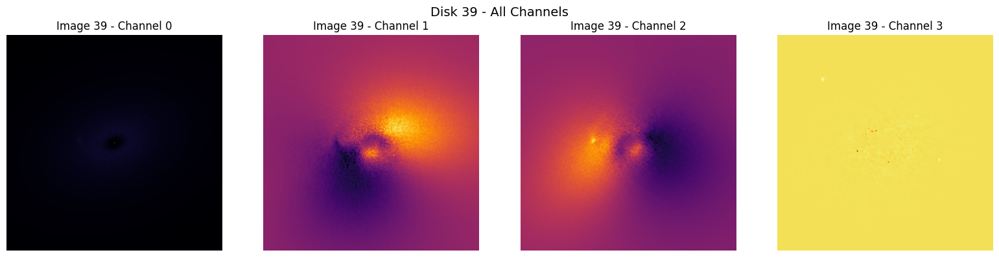

(600, 600, 4)


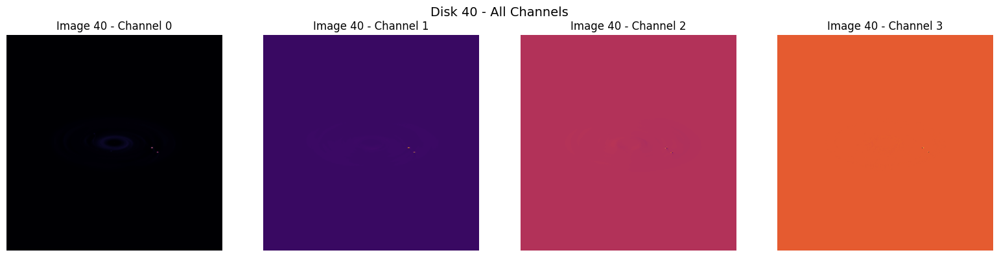

(600, 600, 4)


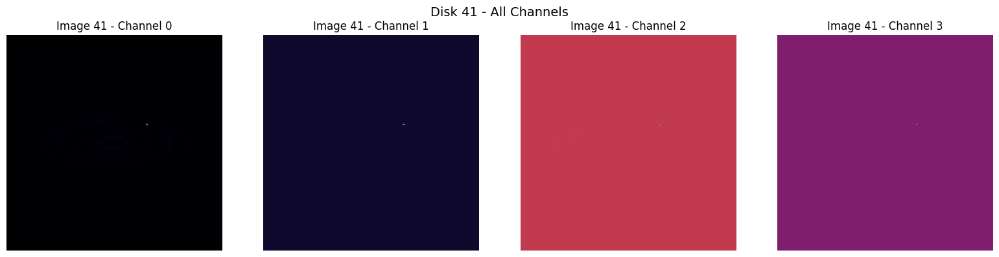

(600, 600, 4)


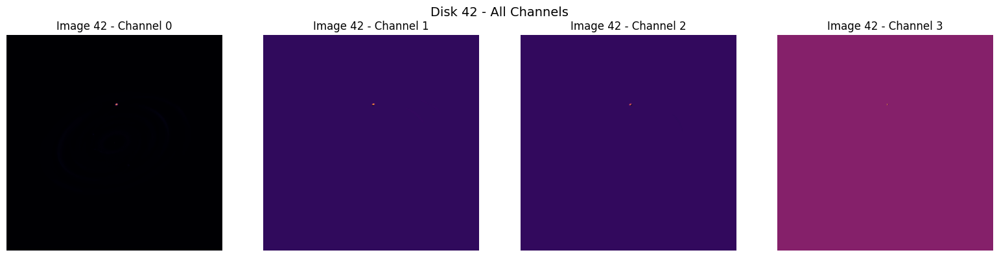

(600, 600, 4)


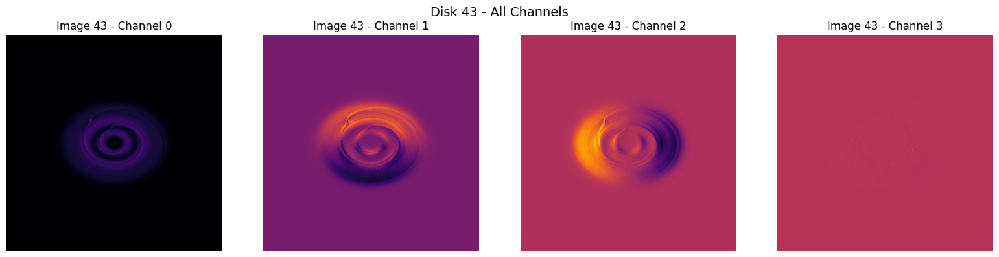

(600, 600, 4)


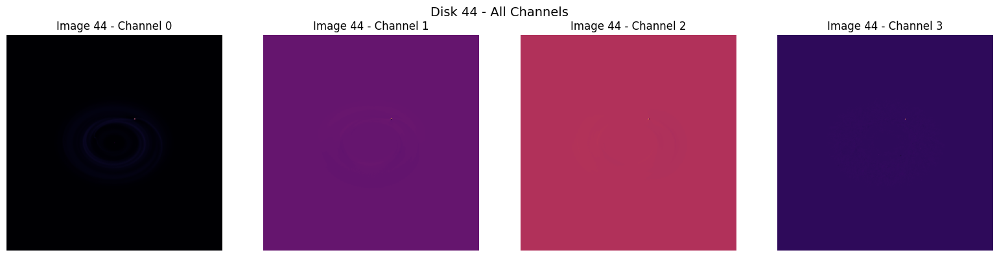

(600, 600, 4)


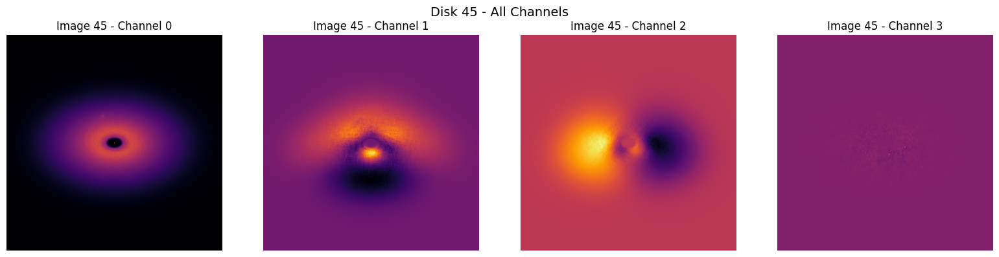

(600, 600, 4)


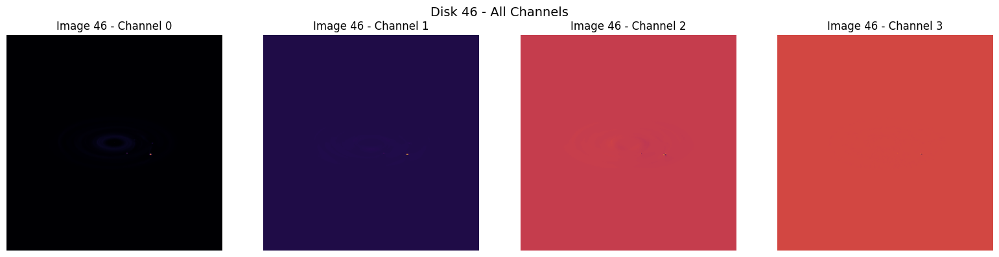

(600, 600, 4)


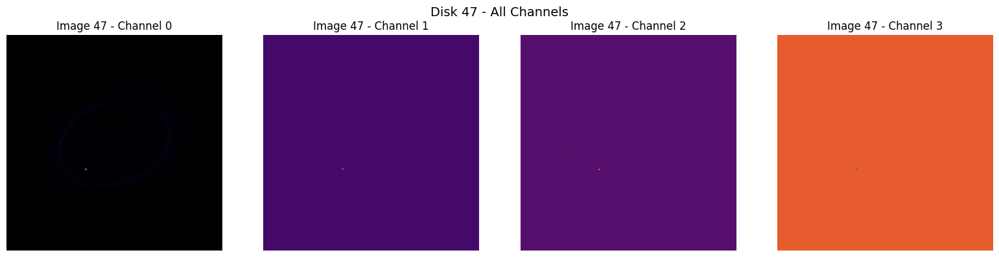

(600, 600, 4)


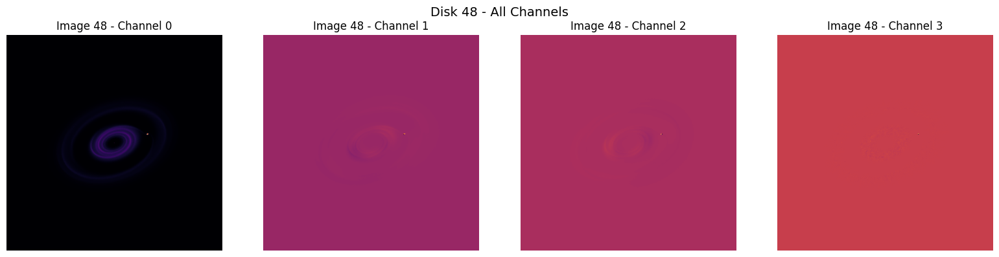

(600, 600, 4)


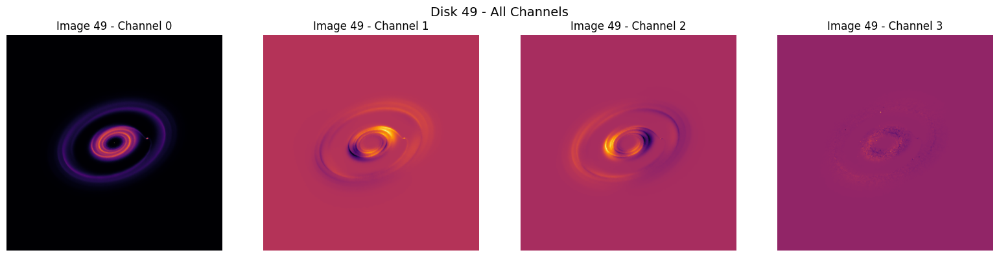

(600, 600, 4)


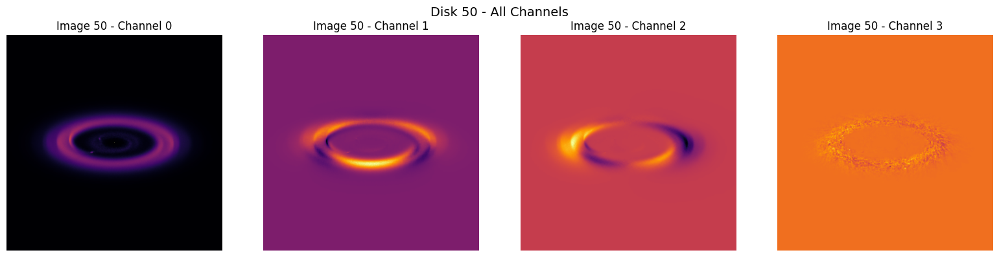

(600, 600, 4)


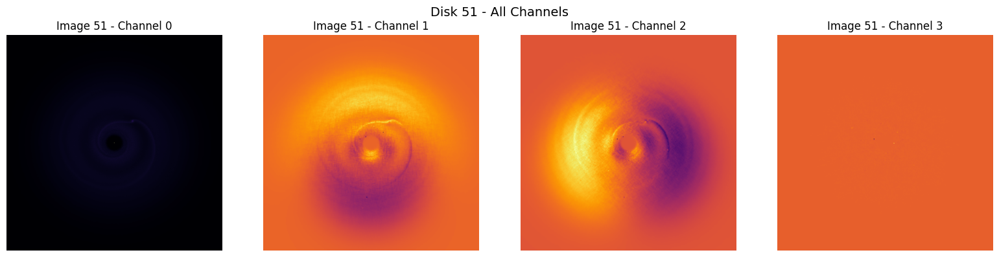

(600, 600, 4)


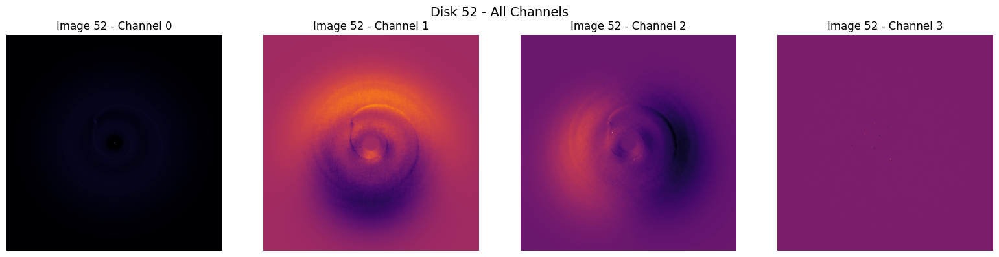

(600, 600, 4)


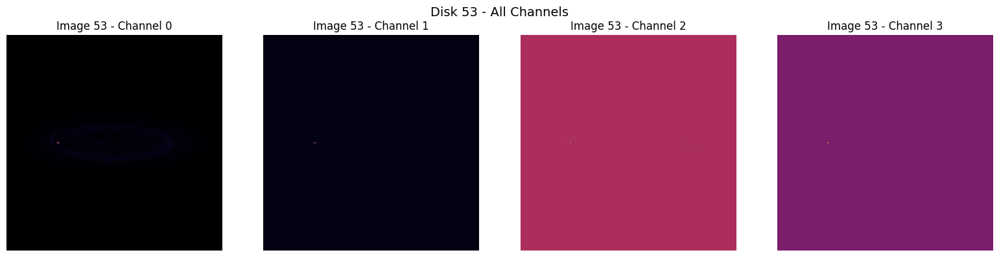

(600, 600, 4)


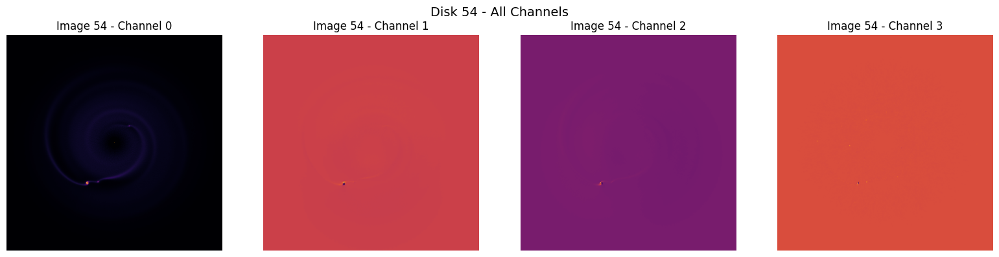

(600, 600, 4)


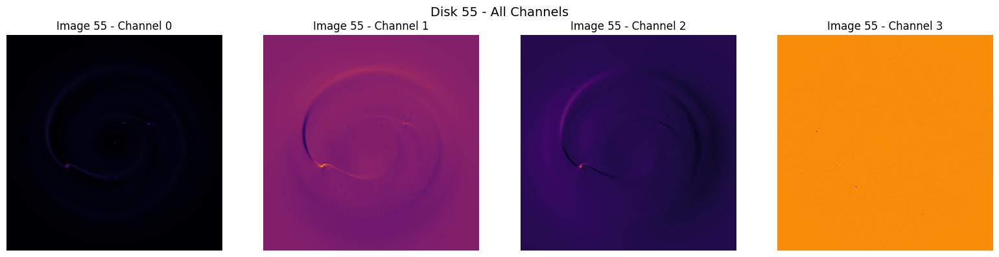

(600, 600, 4)


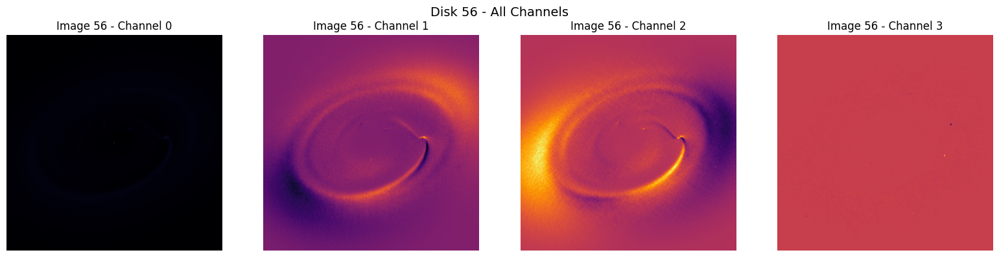

(600, 600, 4)


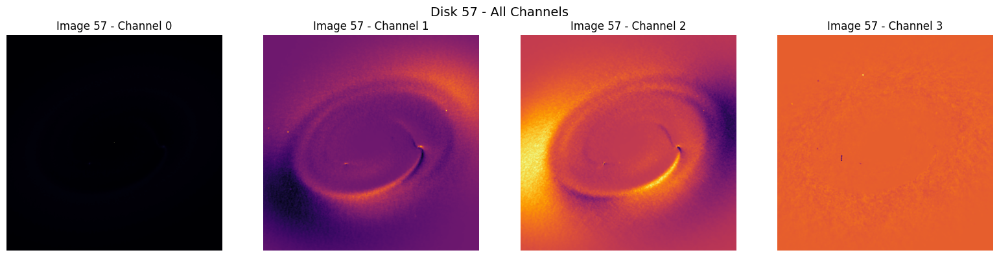

(600, 600, 4)


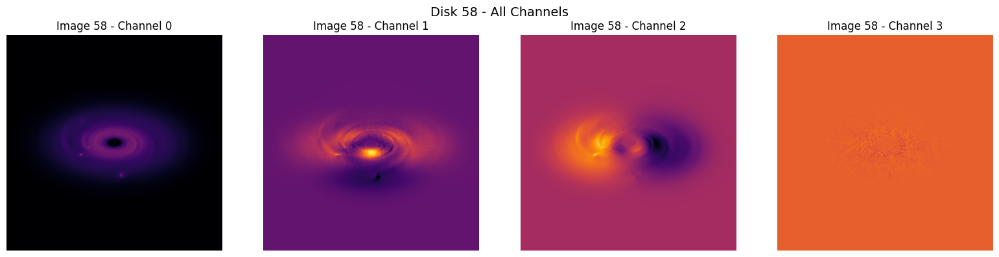

(600, 600, 4)


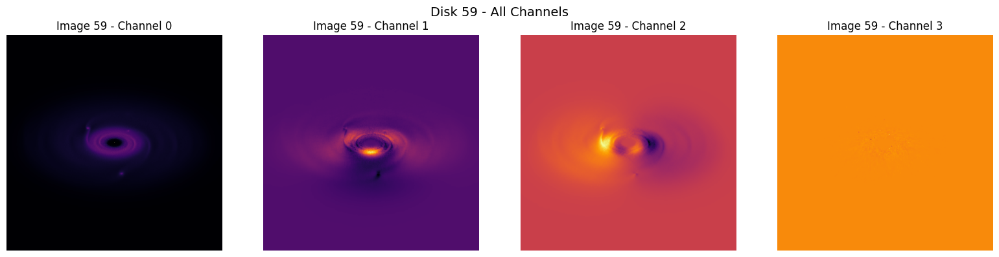

(600, 600, 4)


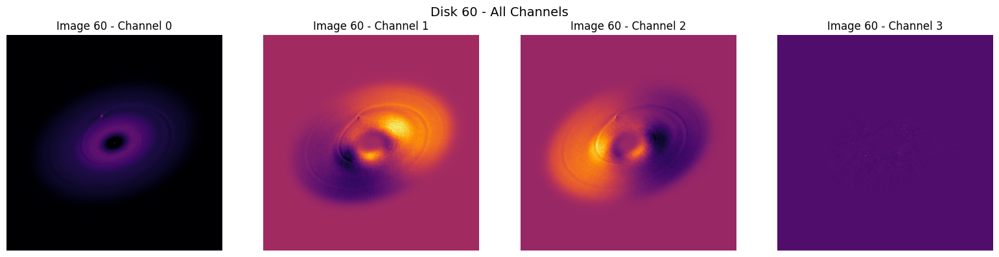

(600, 600, 4)


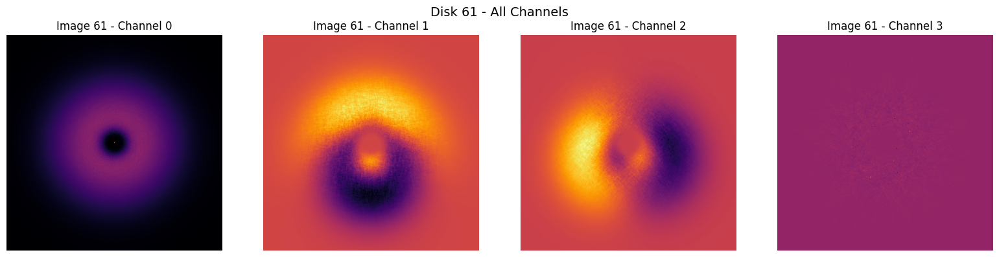

(600, 600, 4)


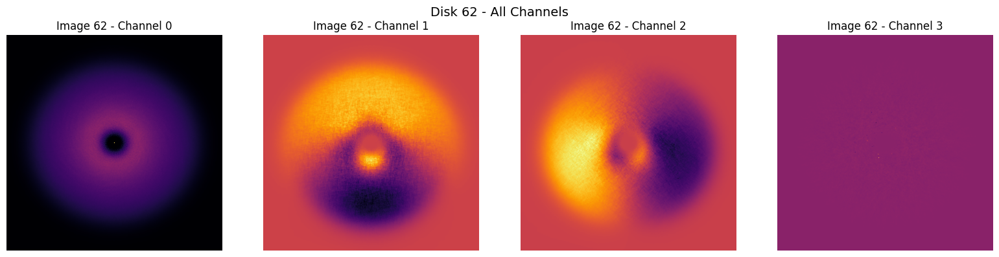

(600, 600, 4)


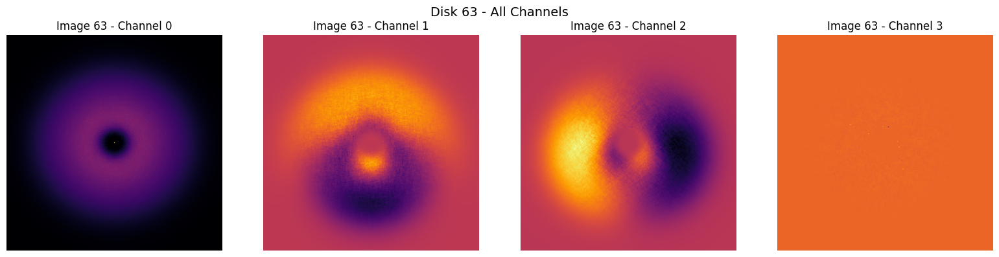

(600, 600, 4)


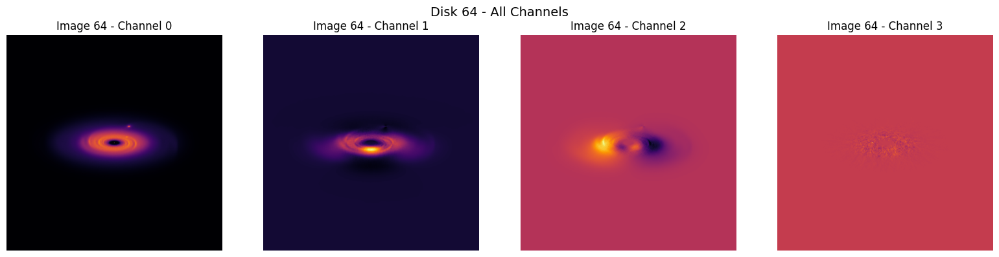

(600, 600, 4)


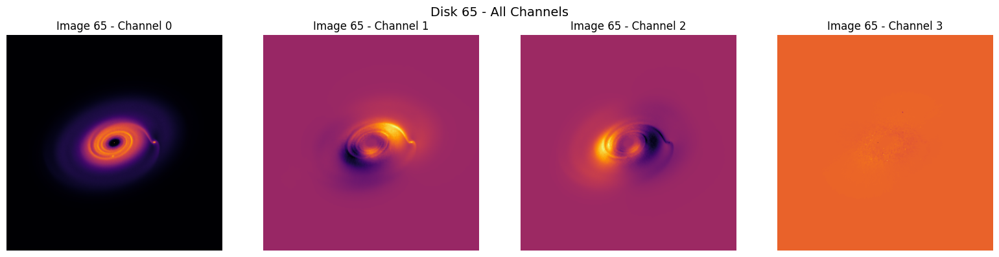

(600, 600, 4)


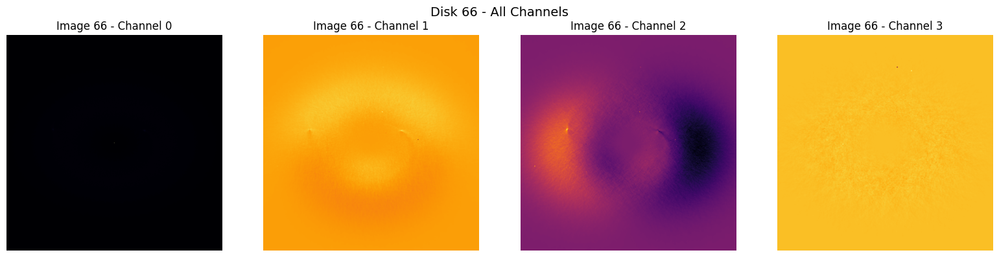

(600, 600, 4)


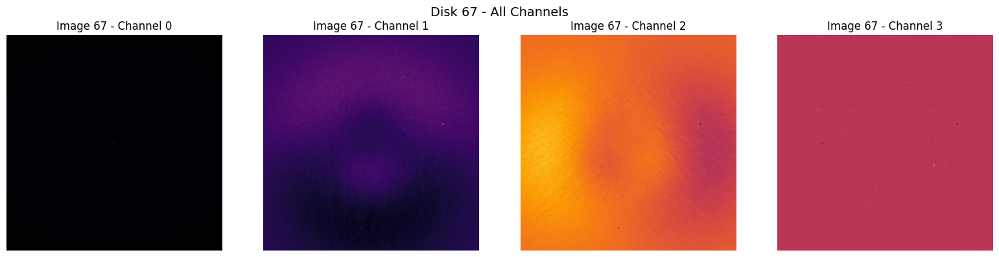

(600, 600, 4)


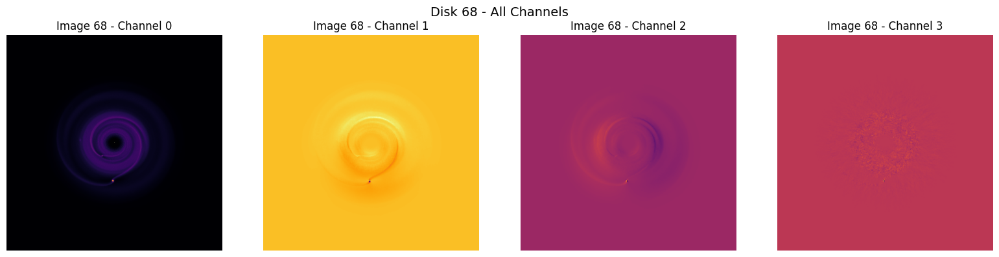

(600, 600, 4)


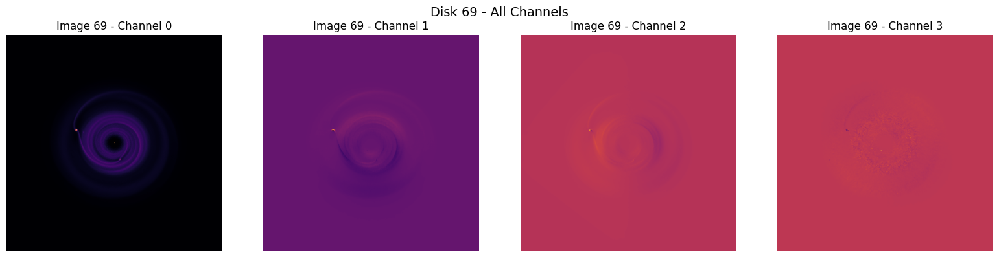

(600, 600, 4)


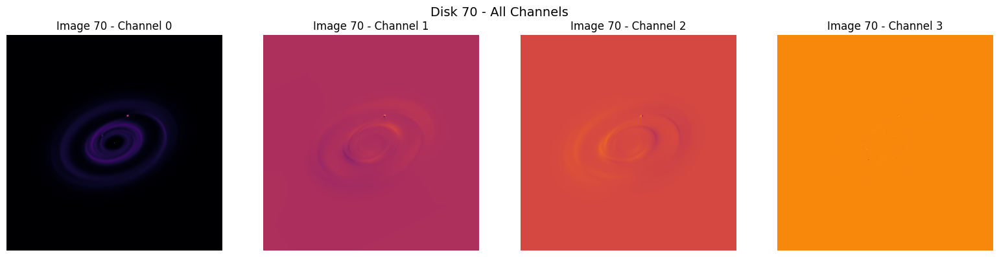

(600, 600, 4)


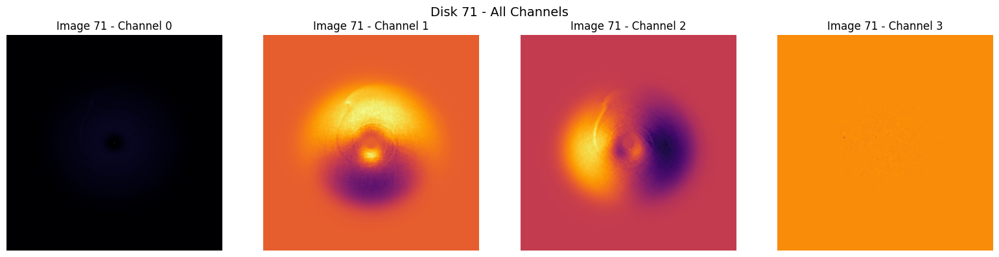

(600, 600, 4)


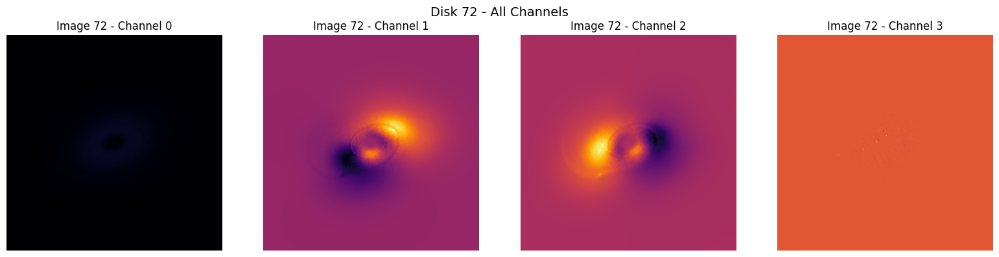

(600, 600, 4)


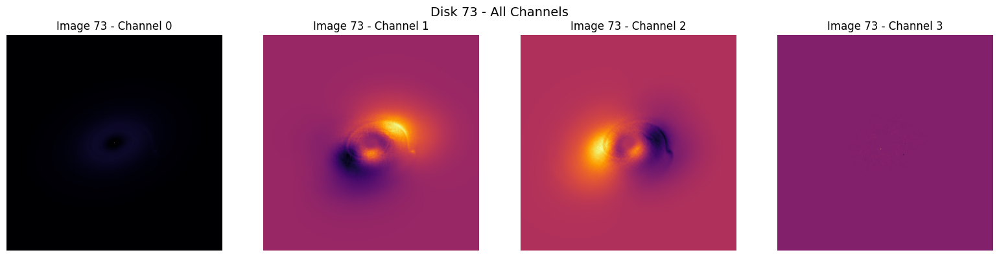

(600, 600, 4)


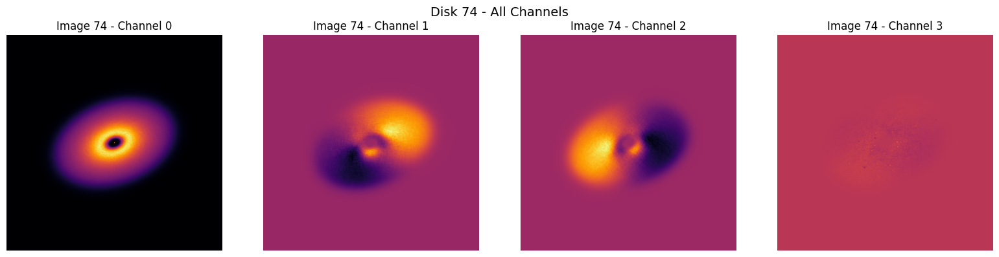

(600, 600, 4)


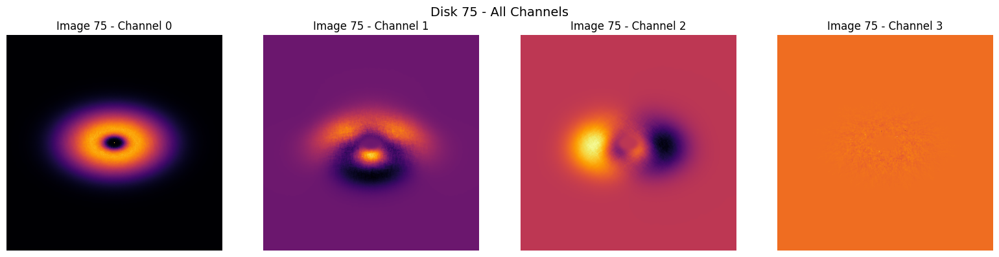

(600, 600, 4)


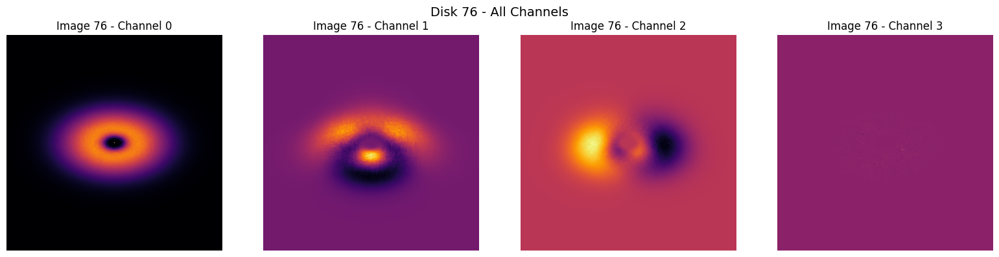

(600, 600, 4)


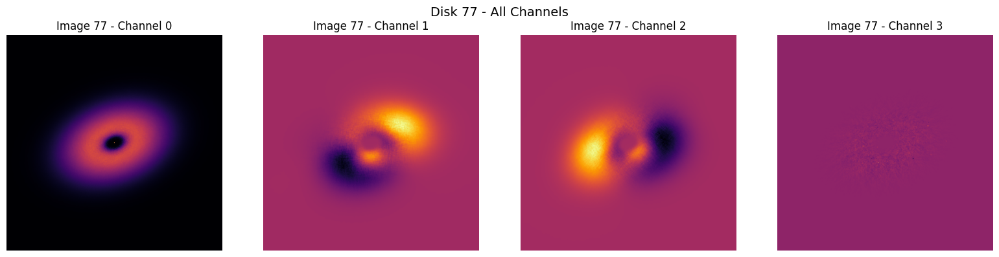

(600, 600, 4)


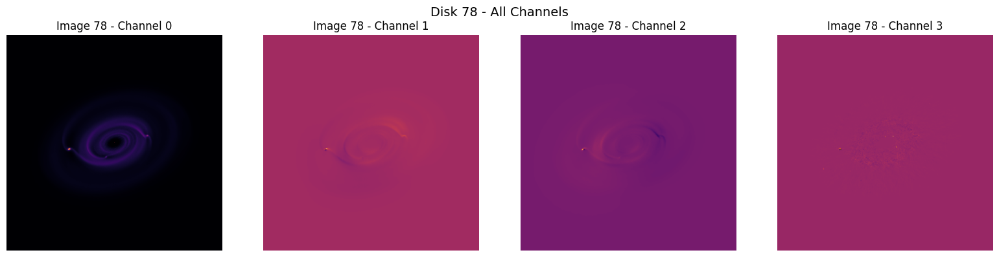

(600, 600, 4)


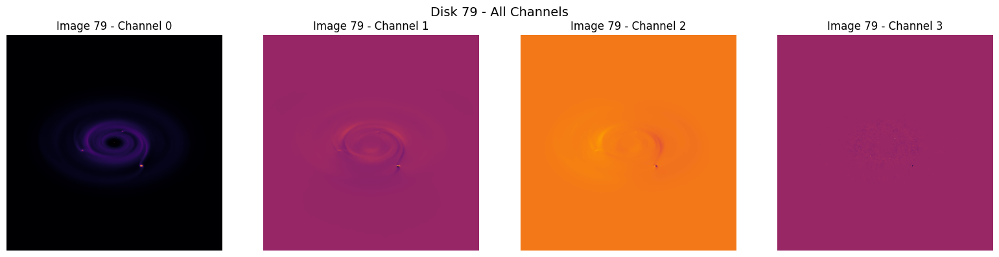

(600, 600, 4)


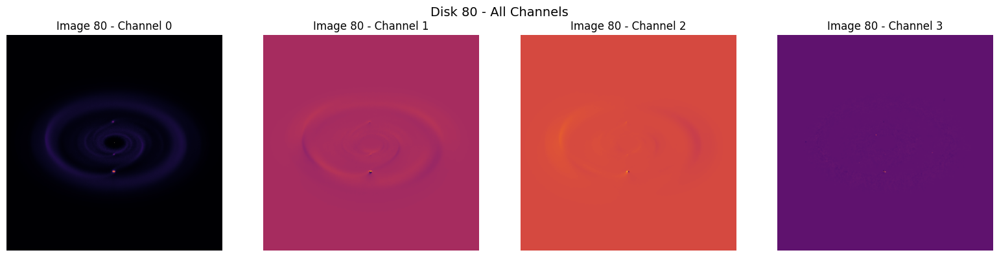

(600, 600, 4)


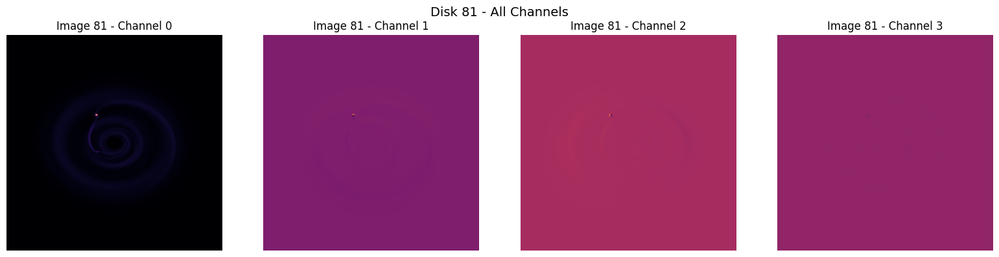

(600, 600, 4)


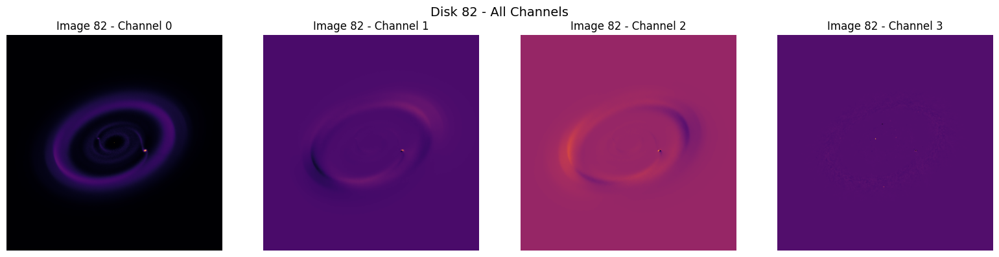

(600, 600, 4)


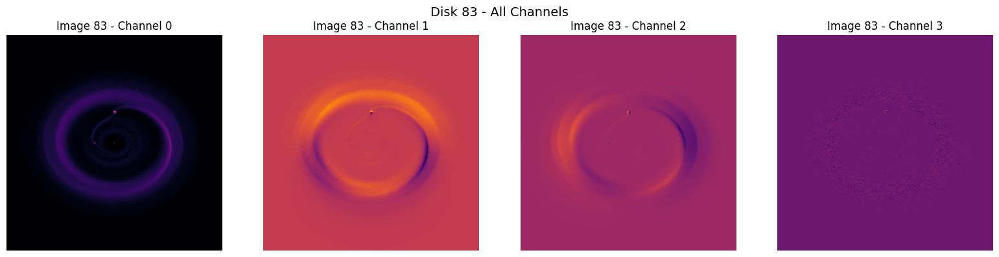

(600, 600, 4)


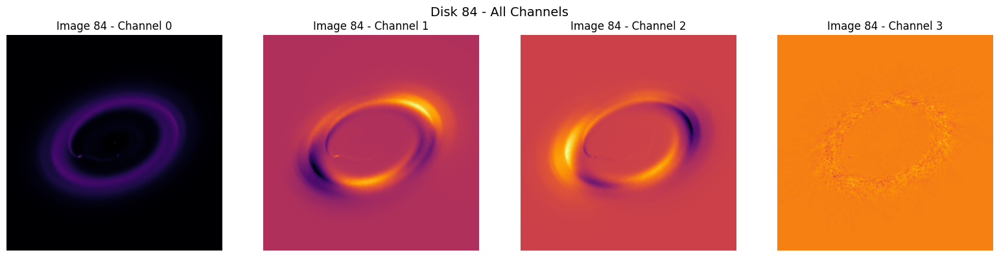

(600, 600, 4)


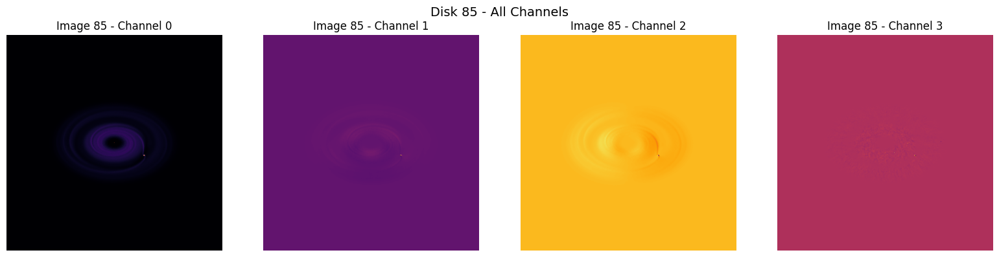

(600, 600, 4)


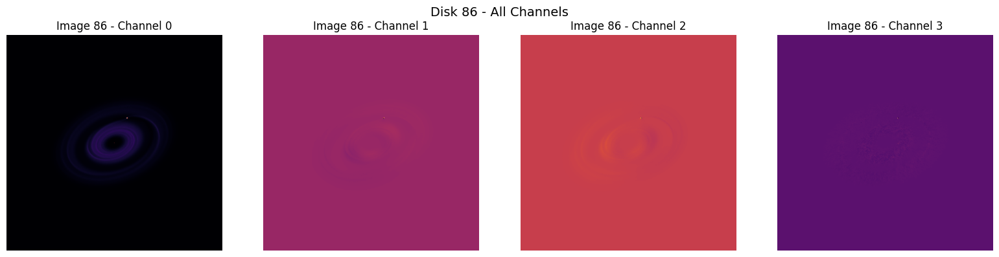

(600, 600, 4)


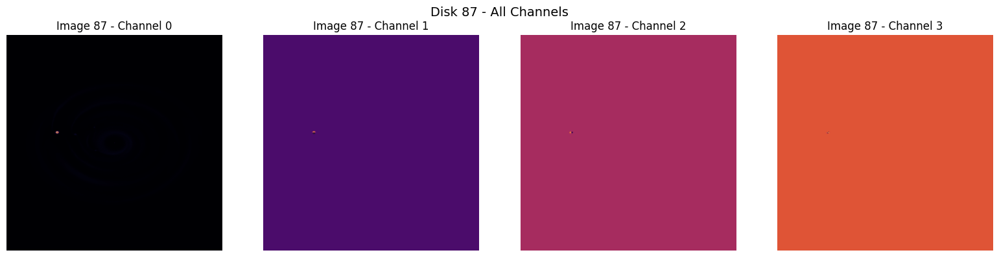

(600, 600, 4)


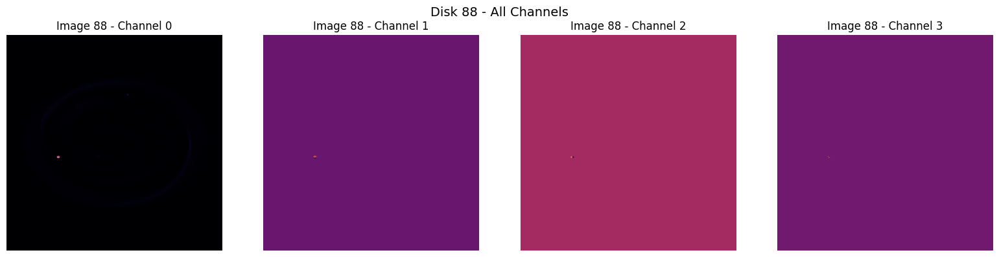

(600, 600, 4)


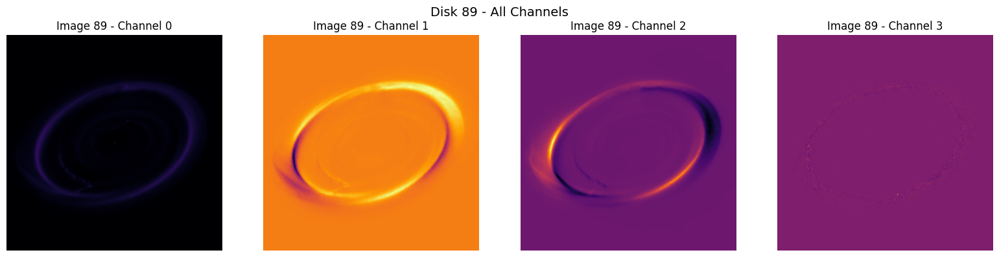

(600, 600, 4)


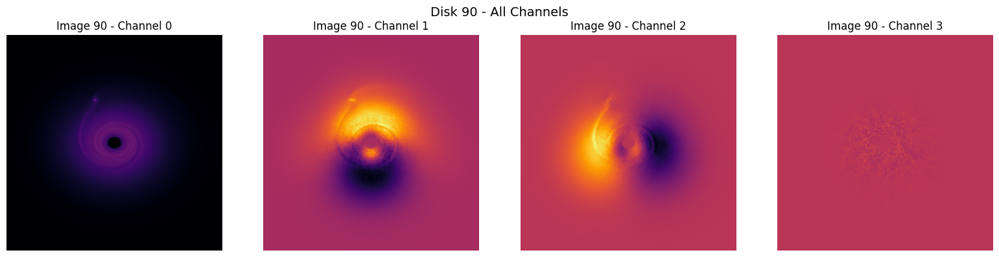

(600, 600, 4)


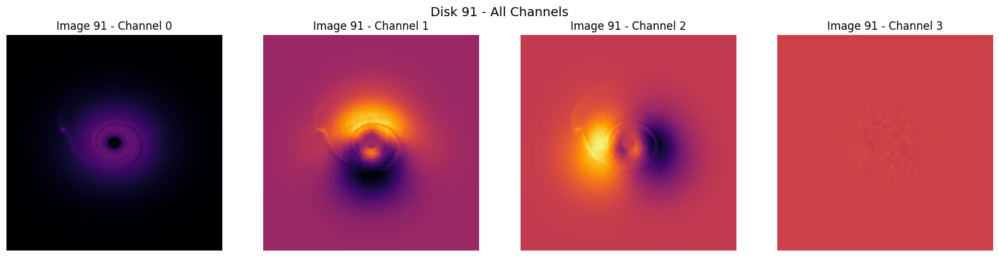

(600, 600, 4)


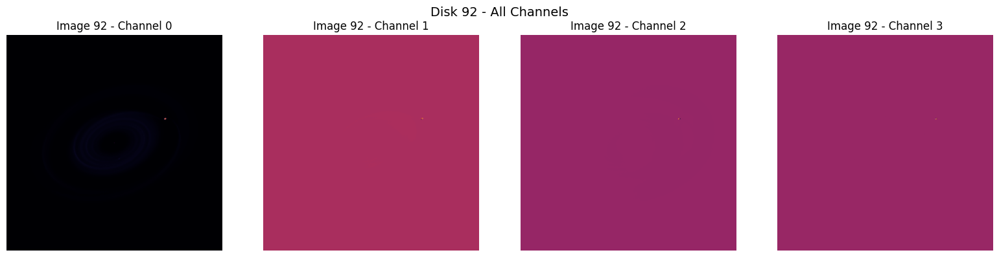

(600, 600, 4)


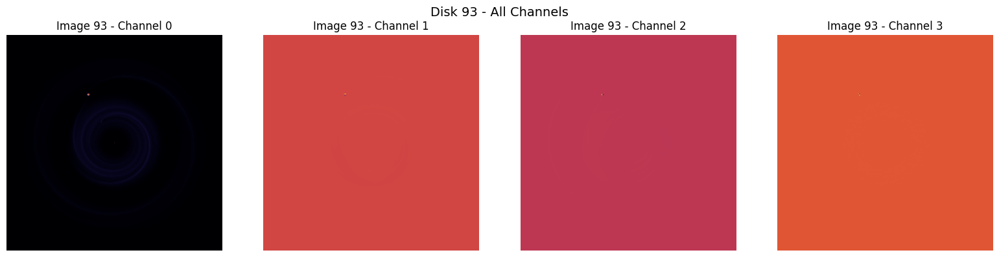

(600, 600, 4)


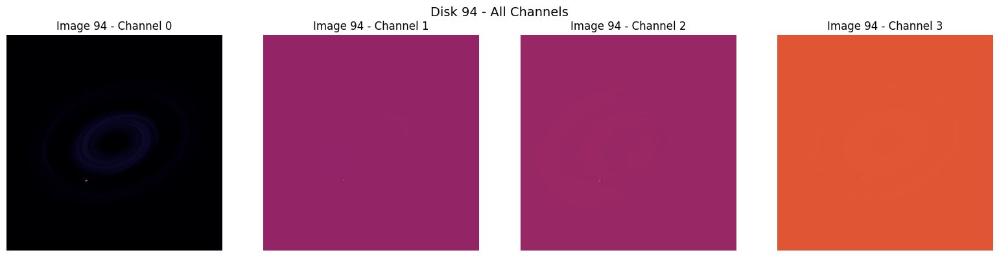

(600, 600, 4)


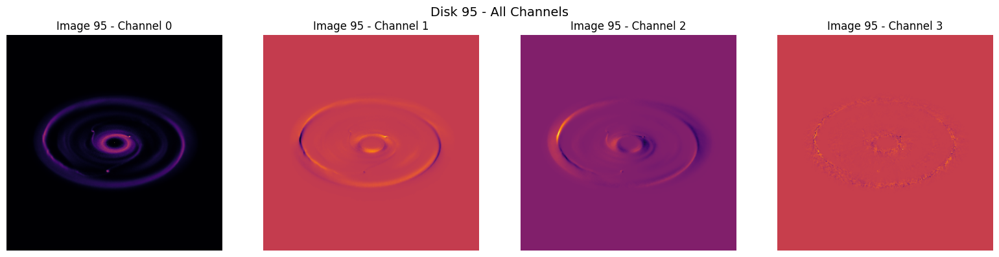

(600, 600, 4)


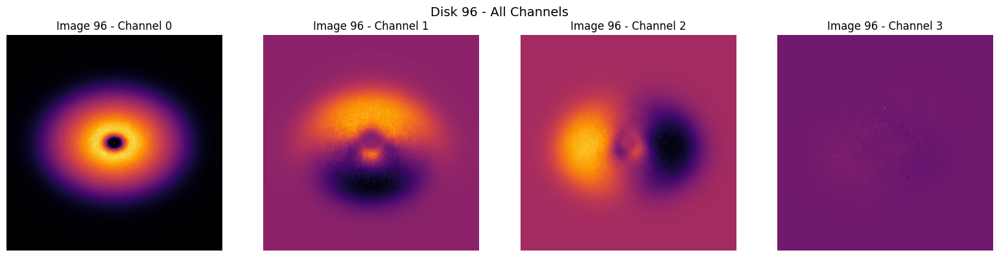

(600, 600, 4)


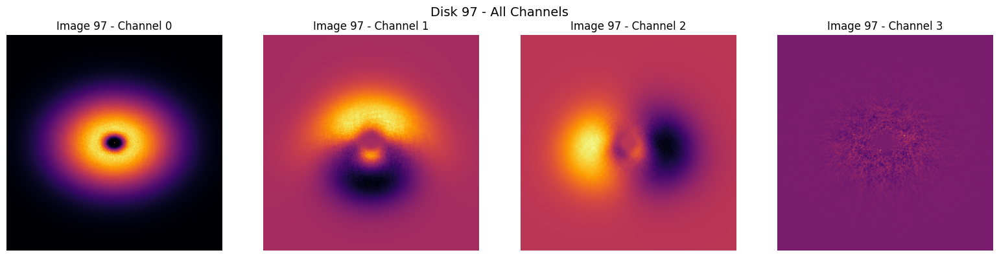

(600, 600, 4)


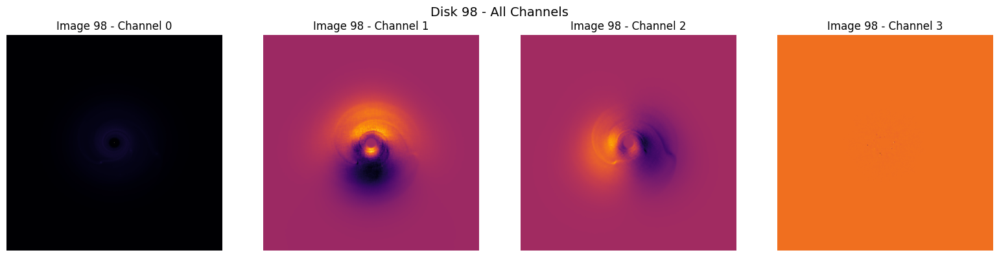

(600, 600, 4)


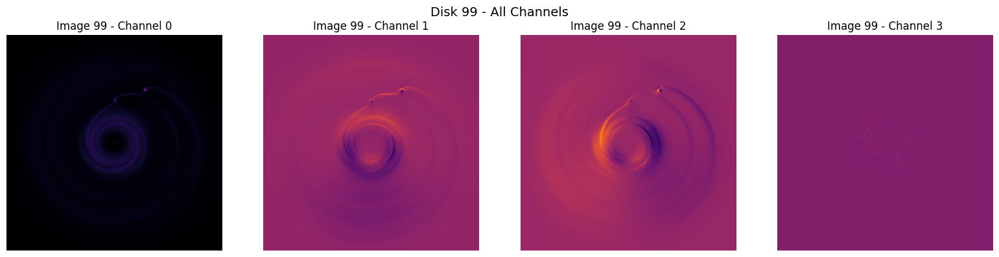

(600, 600, 4)


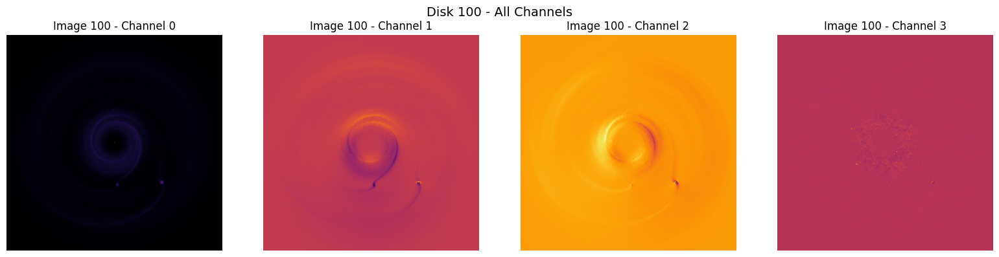

(600, 600, 4)


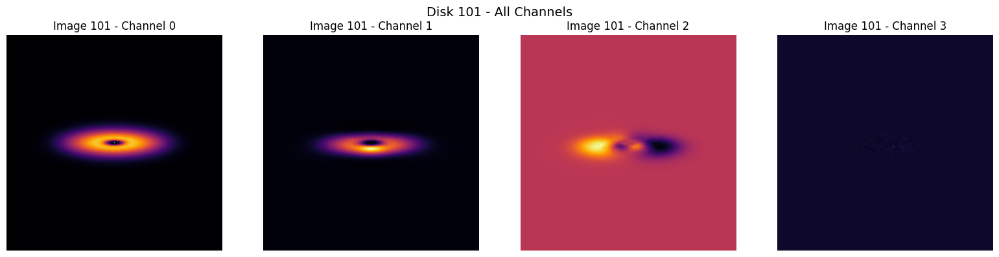

(600, 600, 4)


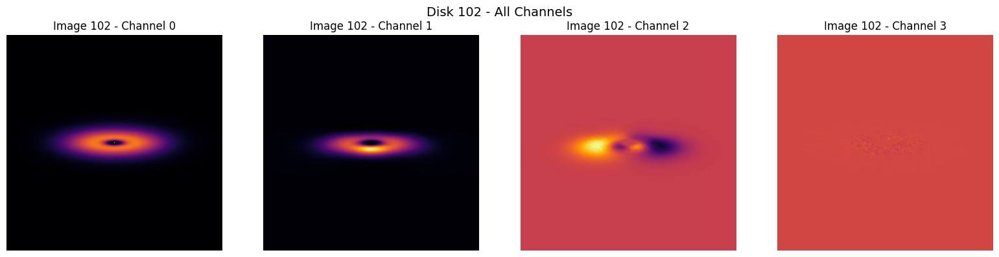

(600, 600, 4)


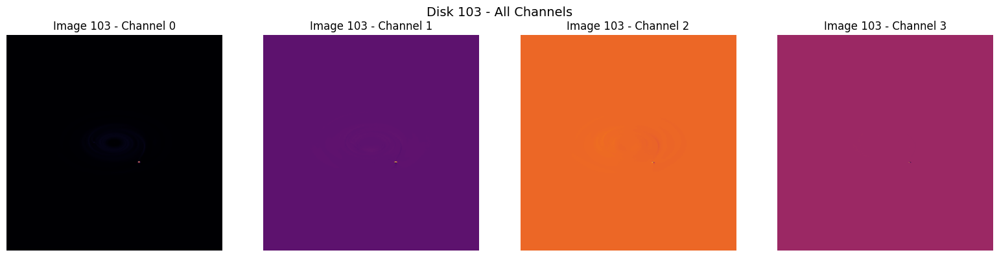

(600, 600, 4)


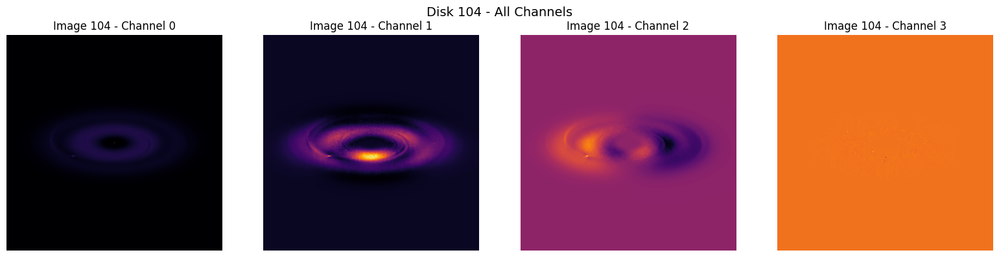

(600, 600, 4)


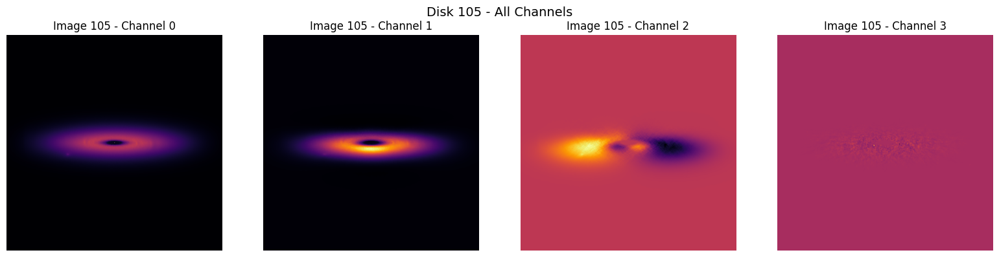

(600, 600, 4)


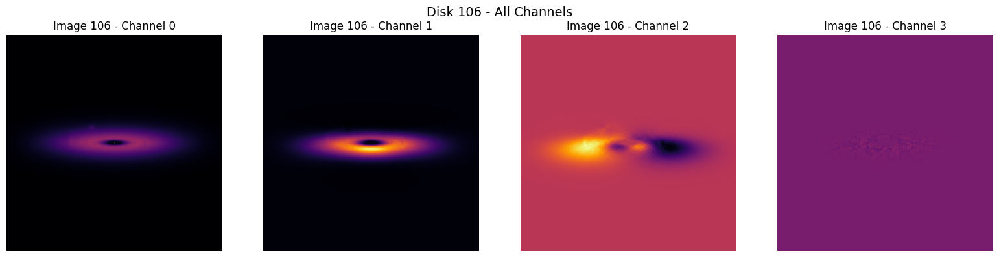

(600, 600, 4)


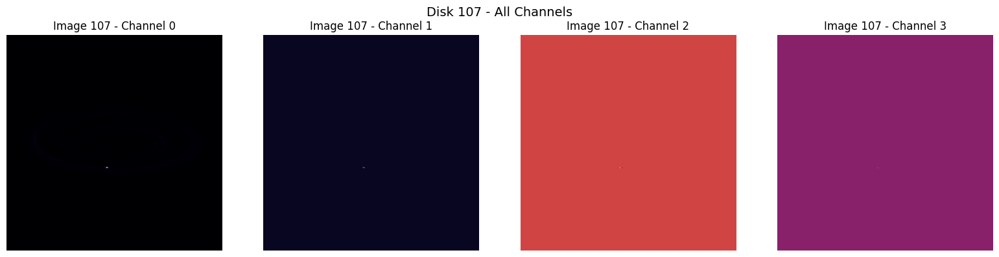

(600, 600, 4)


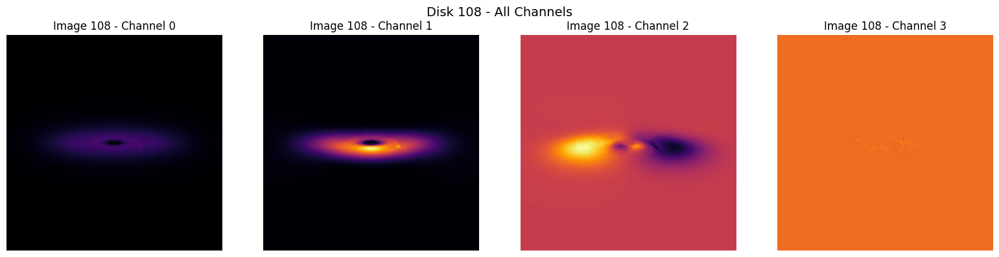

(600, 600, 4)


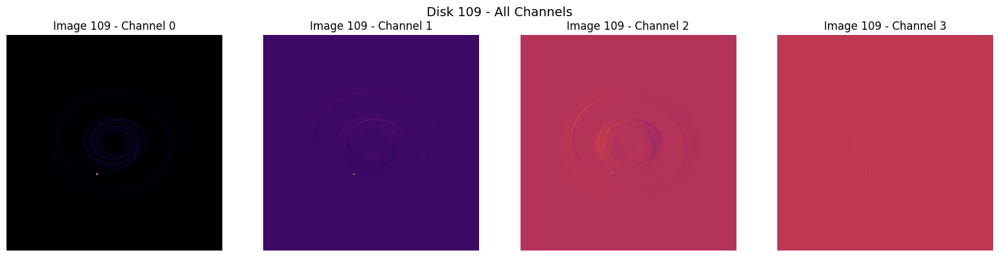

(600, 600, 4)


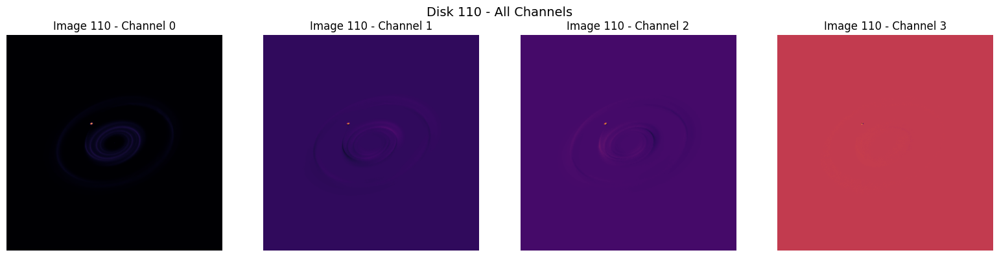

(600, 600, 4)


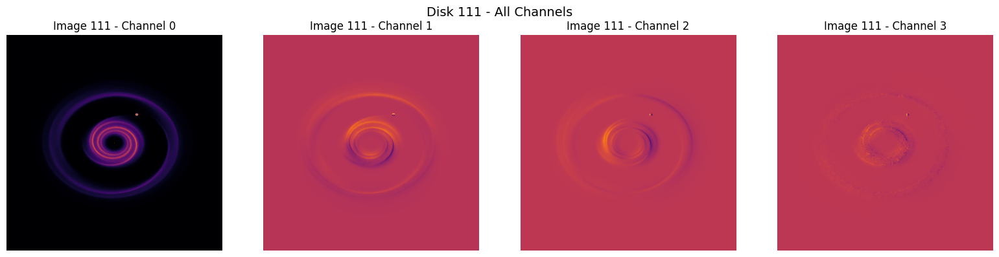

(600, 600, 4)


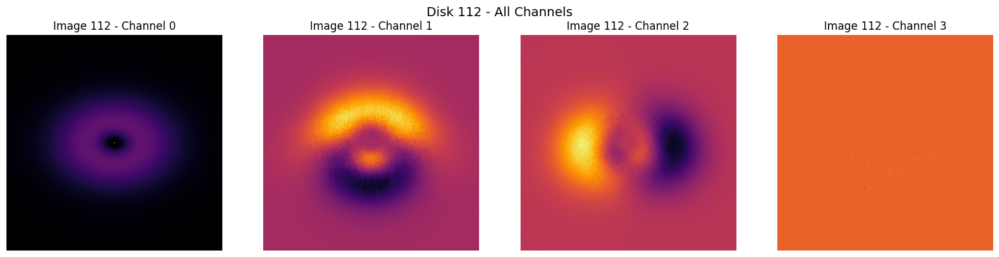

(600, 600, 4)


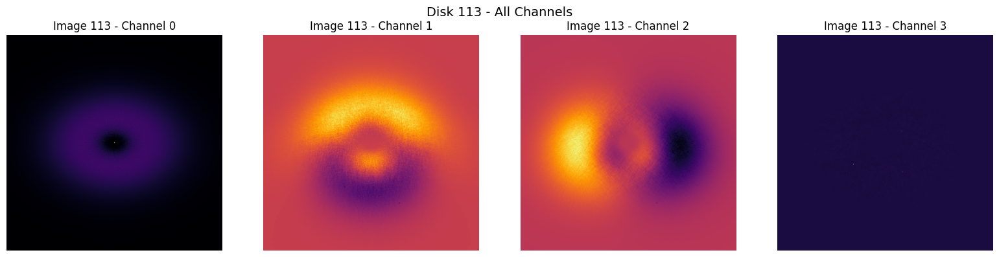

(600, 600, 4)


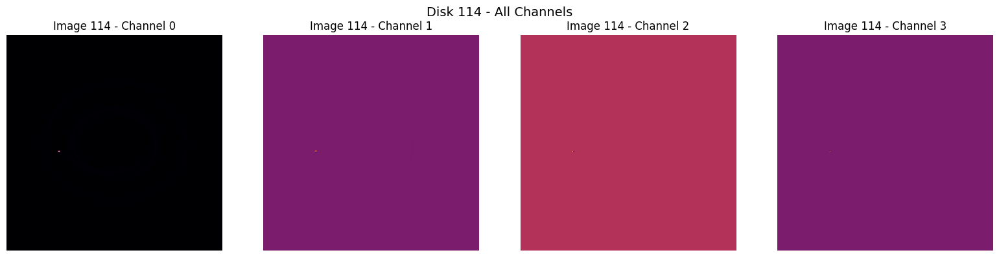

(600, 600, 4)


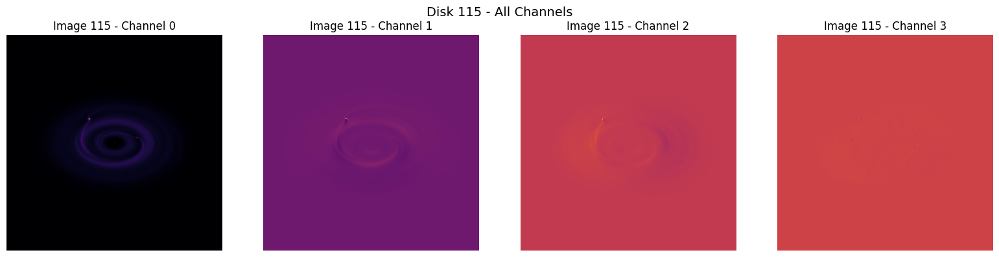

(600, 600, 4)


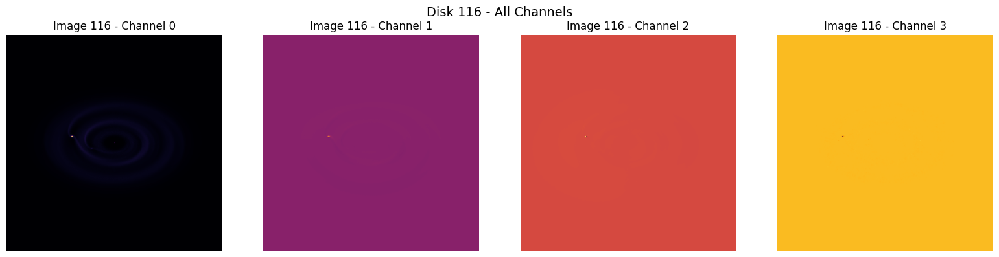

(600, 600, 4)


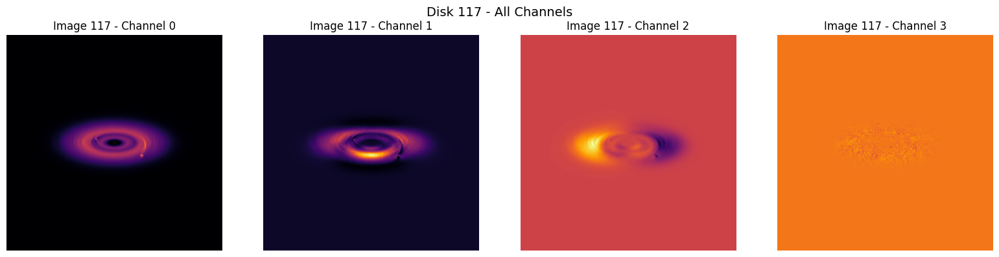

(600, 600, 4)


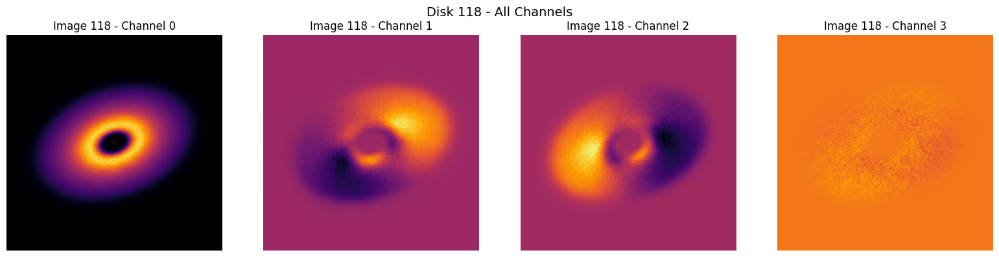

(600, 600, 4)


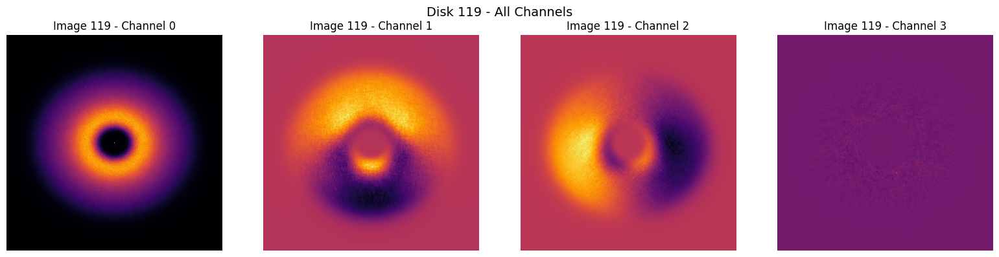

(600, 600, 4)


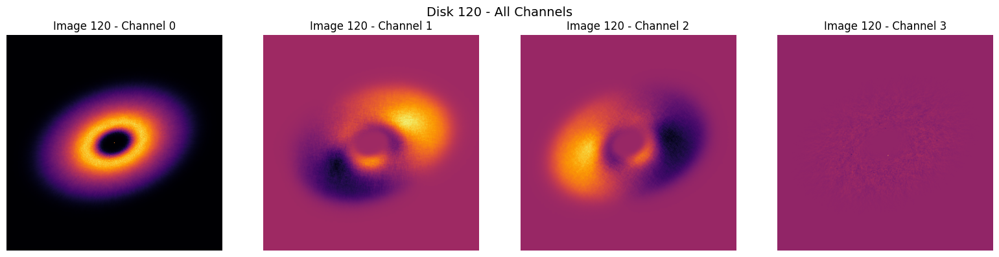

(600, 600, 4)


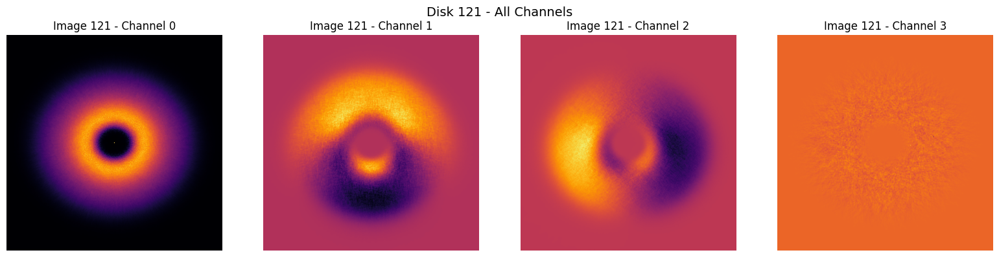

(600, 600, 4)


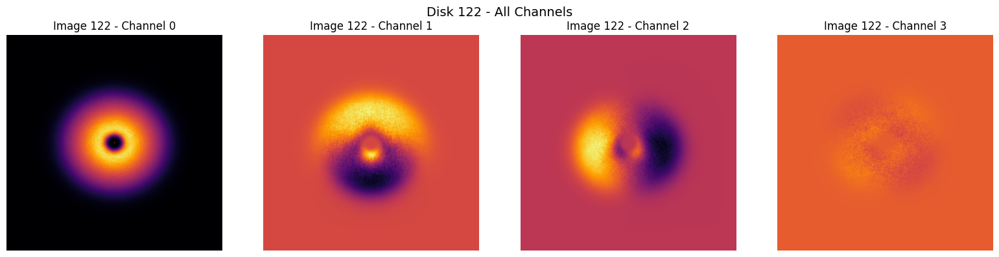

(600, 600, 4)


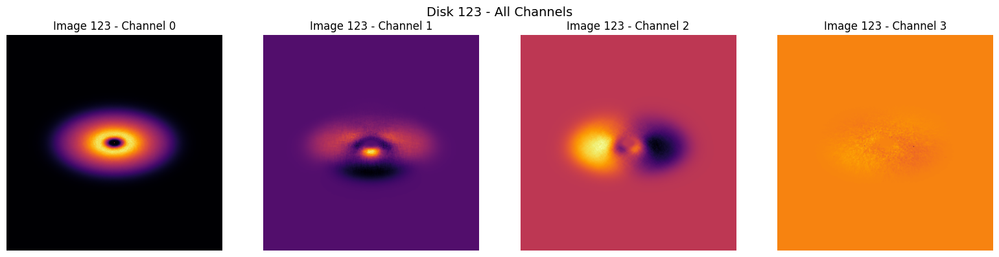

(600, 600, 4)


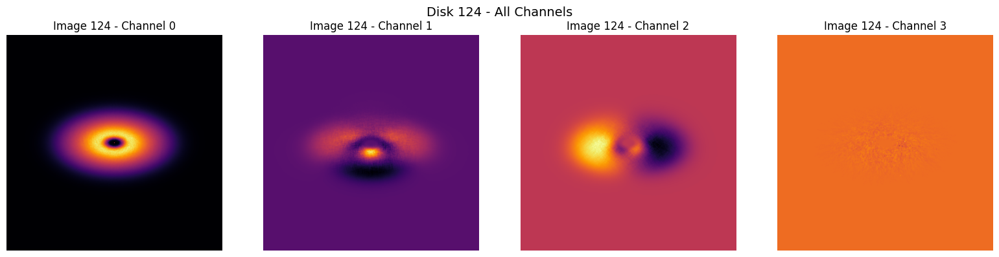

(600, 600, 4)


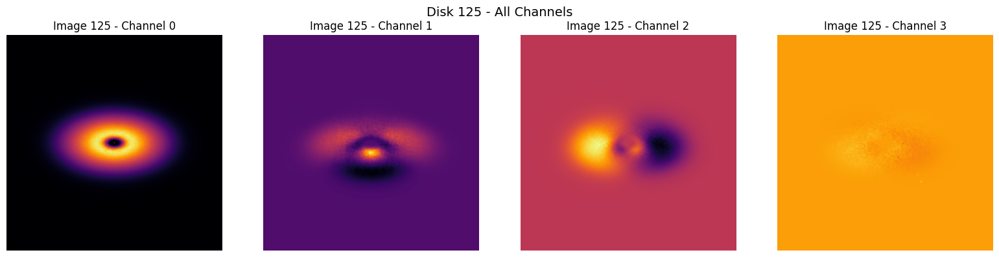

(600, 600, 4)


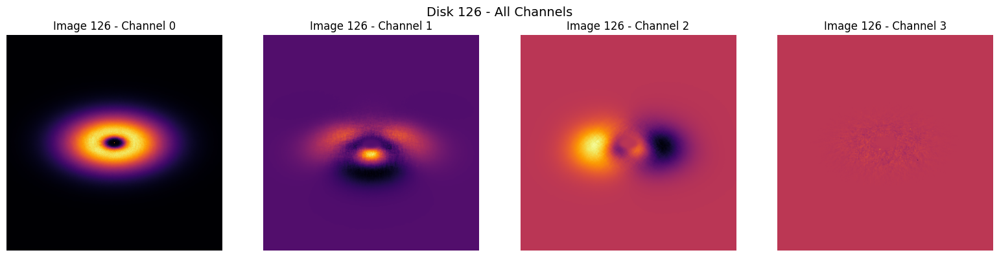

(600, 600, 4)


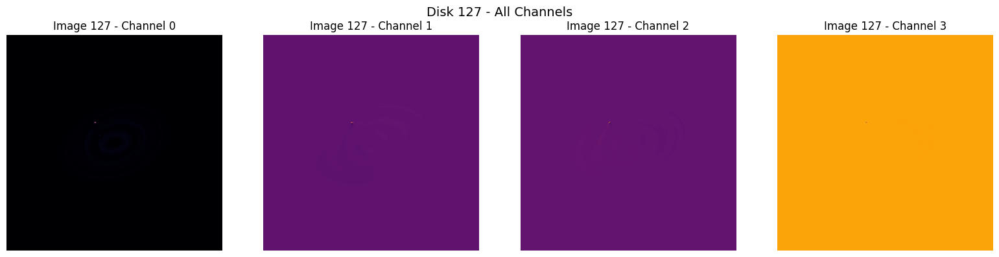

(600, 600, 4)


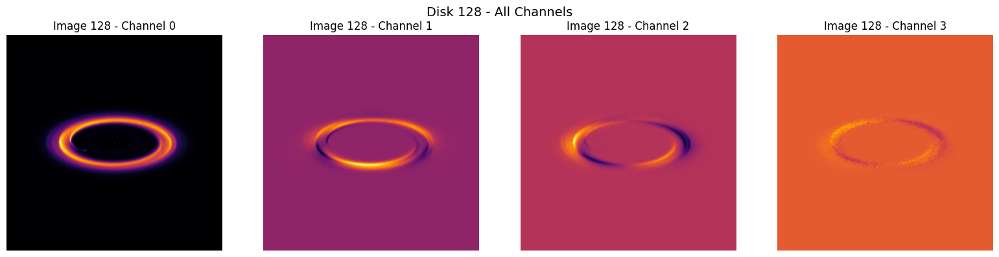

(600, 600, 4)


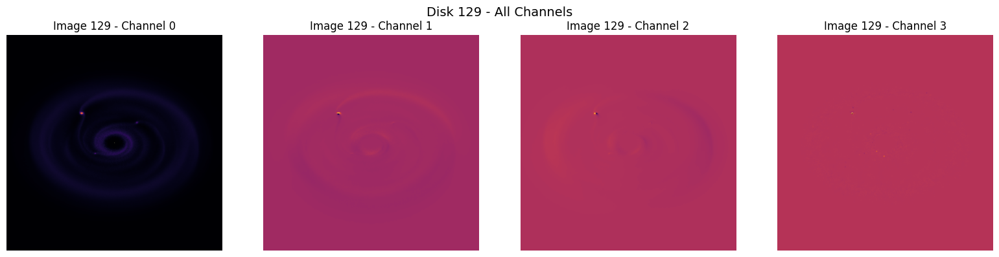

(600, 600, 4)


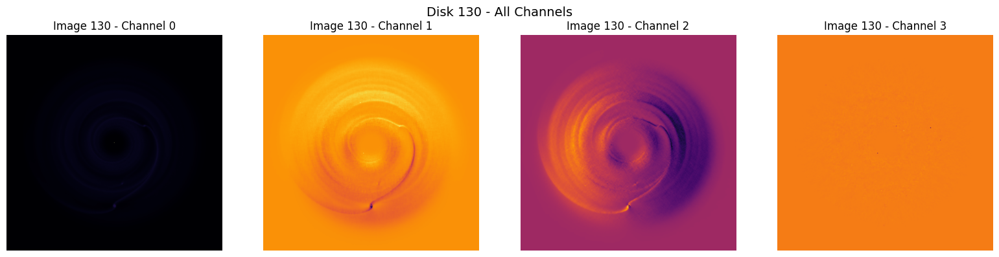

(600, 600, 4)


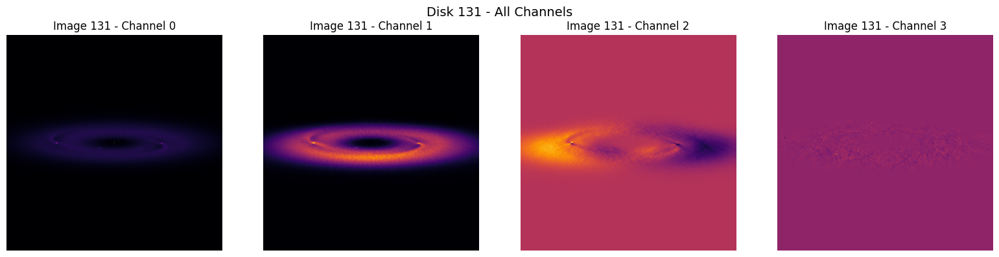

(600, 600, 4)


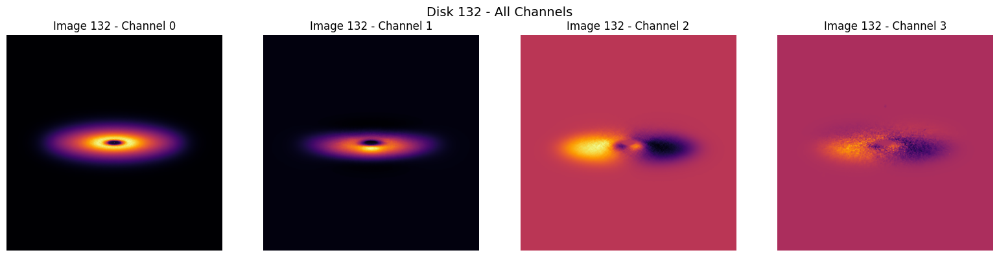

(600, 600, 4)


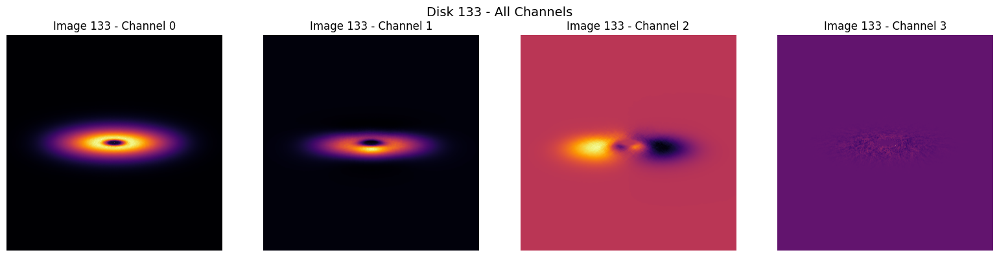

(600, 600, 4)


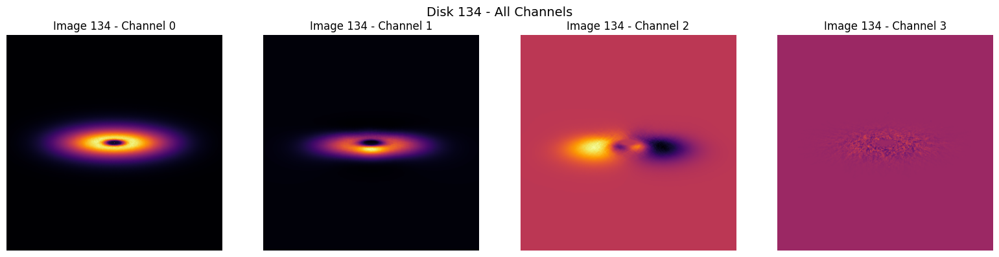

(600, 600, 4)


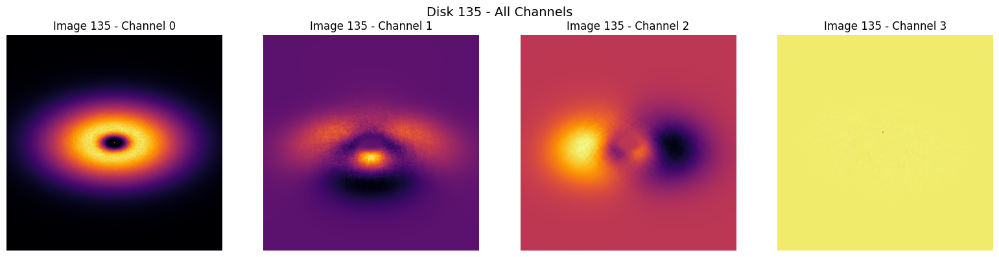

(600, 600, 4)


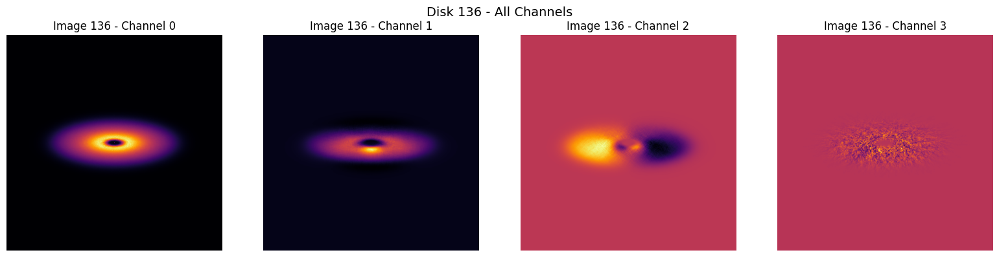

(600, 600, 4)


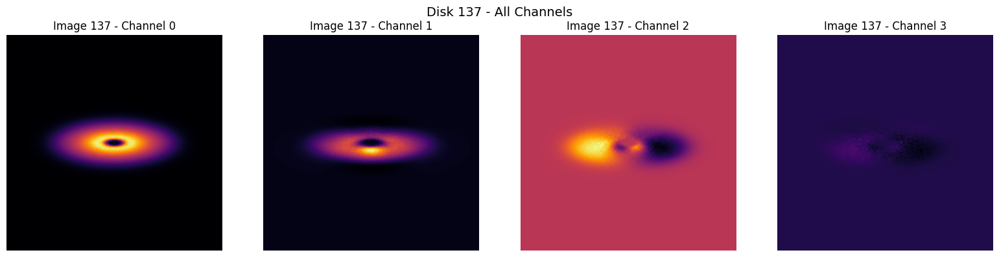

(600, 600, 4)


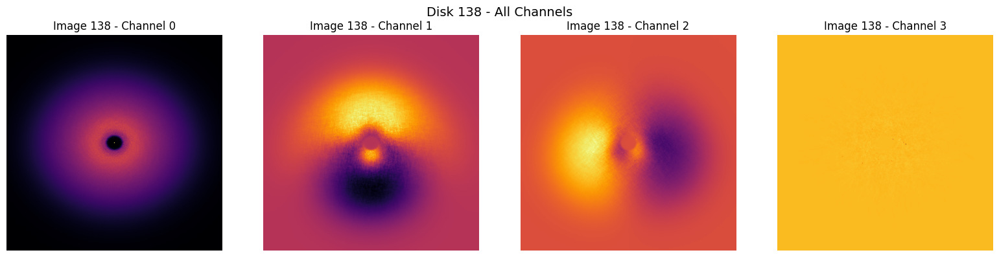

(600, 600, 4)


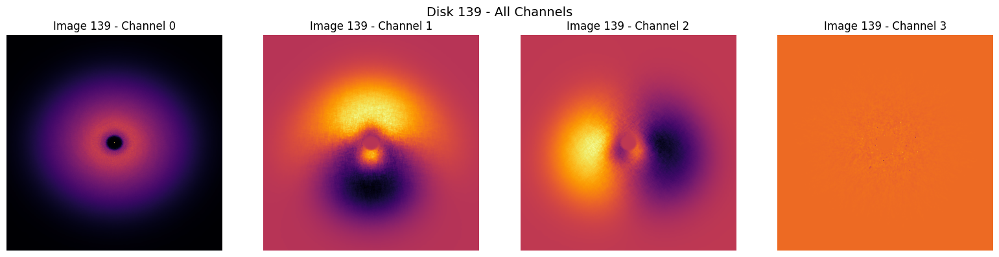

(600, 600, 4)


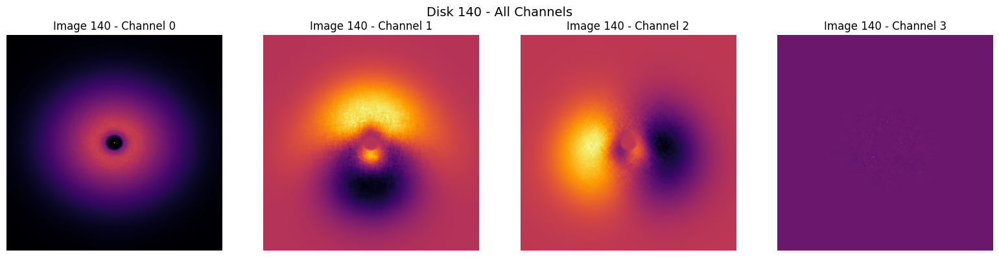

(600, 600, 4)


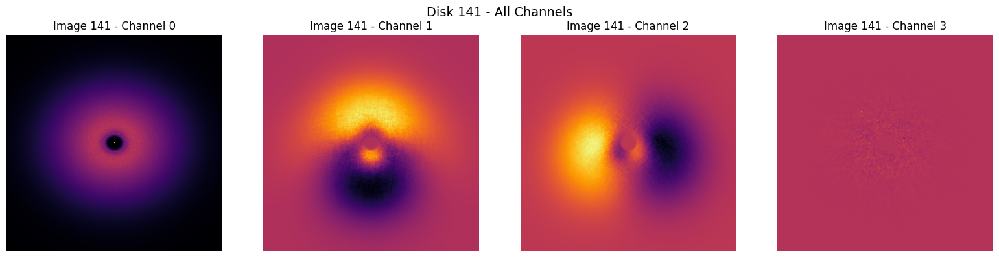

(600, 600, 4)


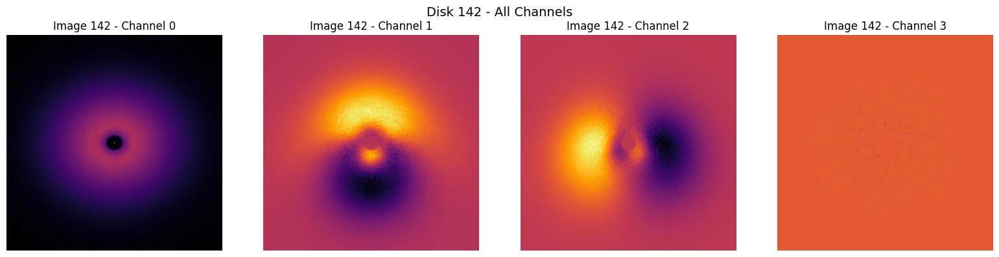

(600, 600, 4)


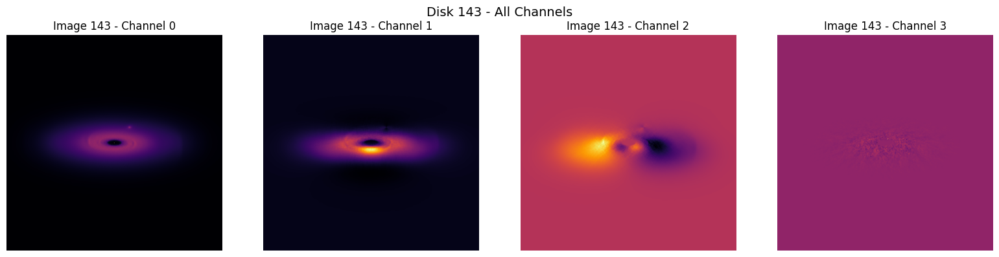

(600, 600, 4)


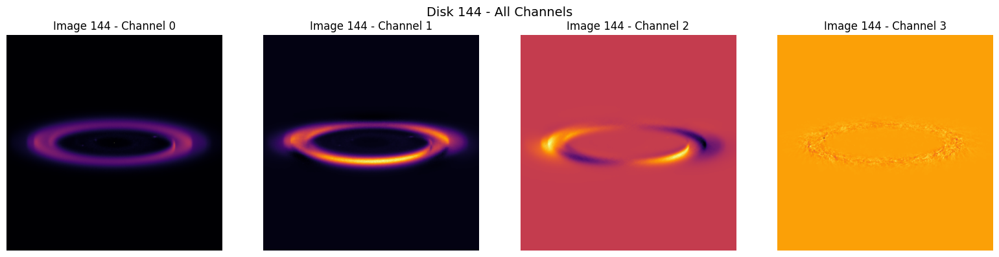

(600, 600, 4)


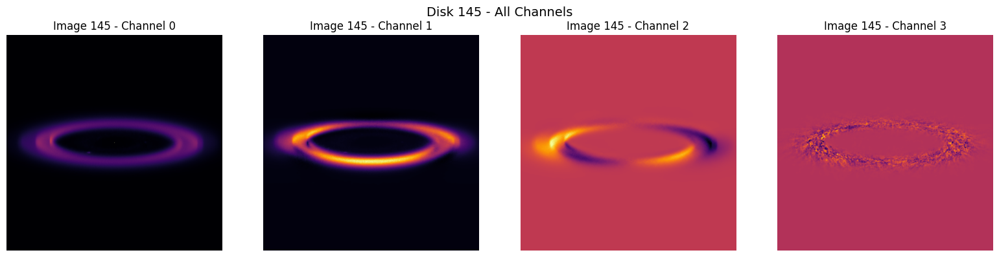

(600, 600, 4)


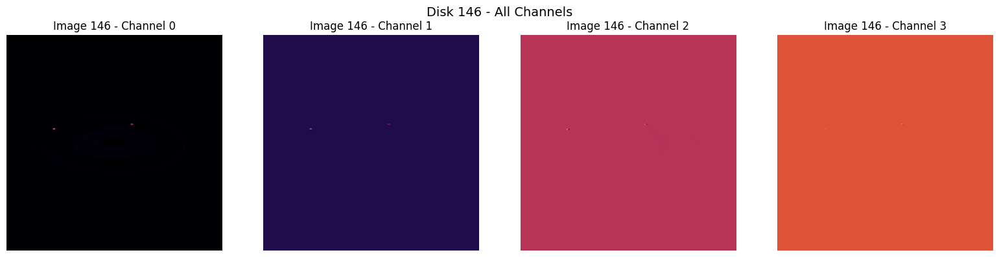

(600, 600, 4)


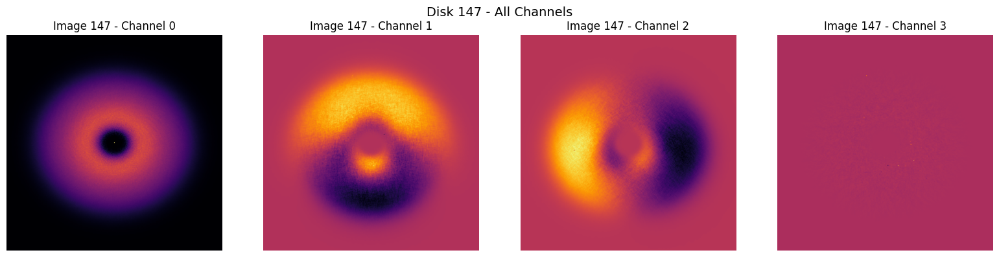

(600, 600, 4)


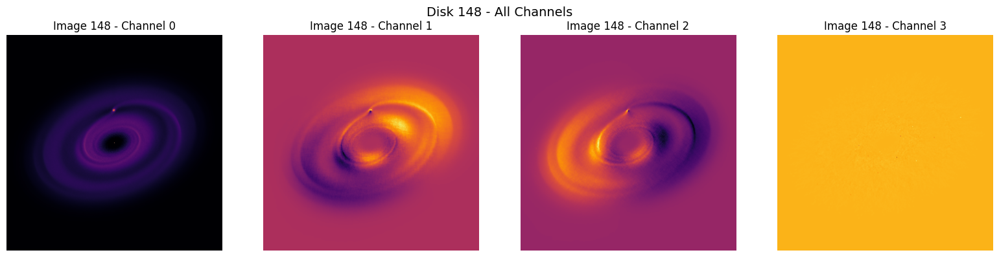

(600, 600, 4)


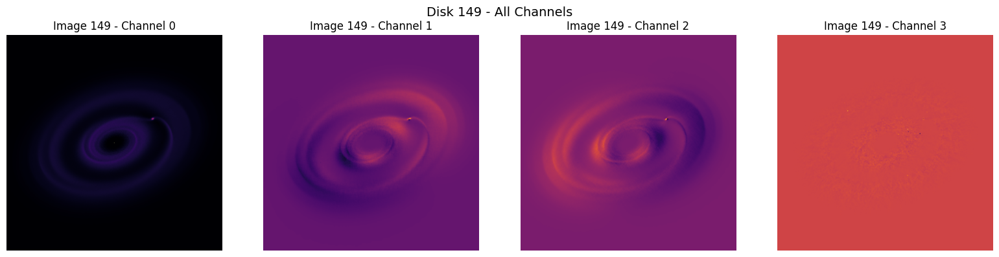

In [13]:

def visualize_all_disks(image_list, max_images=10):
    """
    Visualizes all disk images in the list (up to max_images).
    Each row contains the 4-channel views of one image.
    """
    num_images = min(len(image_list), max_images)

    for i in range(num_images):
        image = image_list[i]  # shape: (600, 600, 4)
        fig, axes = plt.subplots(1, 4, figsize=(16, 4))
        print(image.shape)
        for c in range(image.shape[2]):
            axes[c].imshow(image[:, :, c], cmap='inferno', origin='lower')
            axes[c].set_title(f"Image {i+1} - Channel {c}")
            axes[c].axis("off")

        plt.suptitle(f"Disk {i+1} - All Channels", fontsize=14)
        plt.tight_layout()
        plt.show()
visualize_all_disks(normalised2, max_images=len(normalised2))


In [14]:
"""
Dataset creation
"""
class MultiChannelDataset(Dataset):
    def __init__(self, image_list):
        data = np.array(image_list, dtype=np.float32)
        self.data = torch.tensor(data).permute(0, 3, 1, 2)  # (N, C, H, W)

    def __len__(self):
        return len(self.data)

    def __getitem__(self, idx):
        return self.data[idx], self.data[idx]

In [42]:
class SkipUNet(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64):
        super().__init__()
        self.enc1 = nn.Sequential(nn.Conv2d(in_channels, 16, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.enc2 = nn.Sequential(nn.Conv2d(16, 32, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.enc3 = nn.Sequential(nn.Conv2d(32, 64, 3, padding=1), nn.ReLU(), nn.MaxPool2d(2))
        self.flatten_dim = 64 * 75 * 75
        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)
        self.dec1 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU())
        self.dec2 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(64, 16, 3, padding=1), nn.ReLU())
        self.dec3 = nn.Sequential(nn.Upsample(scale_factor=2), nn.Conv2d(32, in_channels, 3, padding=1), nn.Tanh())

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        e1 = self.enc1(x)
        e2 = self.enc2(e1)
        e3 = self.enc3(e2)
        flat = e3.view(x.size(0), -1)
        mu = self.fc_mu(flat)
        logvar = self.fc_logvar(flat)
        z = self.reparameterize(mu, logvar)
        d = self.decoder_input(z).view(x.size(0), 64, 75, 75)
        d = self.dec1(d)
        d = torch.cat([d, e2], dim=1)
        d = self.dec2(d)
        d = torch.cat([d, e1], dim=1)
        recon = self.dec3(d)
        return recon, mu, logvar, z

In [16]:
class VAE(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64):
        super().__init__()
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 16, 3, stride=2, padding=1), nn.ReLU(),
            nn.Conv2d(16, 32, 3, stride=2, padding=1), nn.ReLU(),
            nn.Conv2d(32, 64, 3, stride=2, padding=1), nn.ReLU()
        )
        self.flatten_dim = 64 * 75 * 75
        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)
        self.decoder = nn.Sequential(
            nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(32, 16, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(16, in_channels, 3, padding=1), nn.Sigmoid()
        )

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        x_enc = self.encoder(x).view(x.size(0), -1)
        mu = self.fc_mu(x_enc)
        logvar = self.fc_logvar(x_enc)
        z = self.reparameterize(mu, logvar)
        x_dec = self.decoder_input(z).view(x.size(0), 64, 75, 75)
        recon = self.decoder(x_dec)
        return recon, mu, logvar, z

In [17]:
class AlexNet(nn.Module):
    def __init__(self, in_channels=1, latent_dim=256):
        super().__init__()
        base = alexnet(pretrained=True).features

        # alexnet takes in 3 channels (RGB design) , so convert in_channels  to 3 to make it compatible
        self.encoder_base = nn.Sequential(nn.Conv2d(in_channels, 3, kernel_size=1), *base)

        # ompute output shape after encoder for decoder
        with torch.no_grad():
            dummy = torch.zeros(1, in_channels, 600, 600)
            dummy_out = self.encoder_base(dummy)
            self.enc_shape = dummy_out.shape[1:]  # (C, H, W)
            self.flatten_dim = int(np.prod(self.enc_shape))

        self.fc_mu = nn.Linear(self.flatten_dim, latent_dim)
        self.fc_logvar = nn.Linear(self.flatten_dim, latent_dim)
        self.decoder_input = nn.Linear(latent_dim, self.flatten_dim)

        # upsampling
        self.decoder = nn.Sequential(
            nn.Upsample(scale_factor=2), nn.Conv2d(self.enc_shape[0], 256, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(256, 128, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(128, 64, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(64, 32, 3, padding=1), nn.ReLU(),
            nn.Upsample(scale_factor=2), nn.Conv2d(32, 16, 3, padding=1), nn.ReLU(),
            nn.Conv2d(16, in_channels, 3, padding=1), nn.Tanh(),
            nn.Upsample(size=(600, 600), mode="bilinear", align_corners=False)
        )

    def reparameterize(self, mu, logvar):
        std = torch.exp(0.5 * logvar)
        eps = torch.randn_like(std)
        return mu + eps * std

    def forward(self, x):
        enc = self.encoder_base(x)
        flat = enc.view(x.size(0), -1)
        mu = self.fc_mu(flat)
        logvar = self.fc_logvar(flat)
        z = self.reparameterize(mu, logvar)
        dec_input = self.decoder_input(z).view(x.size(0), *self.enc_shape)
        return self.decoder(dec_input).to(x.device), mu, logvar, z


In [18]:
class ConvAutoencoder(nn.Module):
    def __init__(self, in_channels=1, latent_dim=64, input_shape=(600, 600)):
        super(ConvAutoencoder, self).__init__()
        self.latent_dim = latent_dim
        self.in_channels = in_channels
        self.input_shape = input_shape

        # Encoder
        self.encoder = nn.Sequential(
            nn.Conv2d(in_channels, 32, kernel_size=3, padding=1),  # (B, 32, H, W)
            nn.ReLU(),
            nn.MaxPool2d(2),                                       # (B, 32, H/2, W/2)
            nn.Conv2d(32, 64, kernel_size=3, padding=1),           # (B, 64, H/2, W/2)
            nn.ReLU(),
            nn.MaxPool2d(2),                                       # (B, 64, H/4, W/4)
            nn.Conv2d(64, 64, kernel_size=3, padding=1),           # (B, 64, H/4, W/4)
            nn.ReLU(),
            nn.MaxPool2d(2)                                        # (B, 64, H/8, W/8)
        )

        # Calculate downsampled size
        h, w = input_shape[0] // 8, input_shape[1] // 8
        self.encoded_shape = (64, h, w)
        self.flat_dim = 64 * h * w

        # Latent
        self.fc1 = nn.Linear(self.flat_dim, 128)
        self.fc_latent = nn.Linear(128, latent_dim)

        # Decoder
        self.fc2 = nn.Linear(latent_dim, 128)
        self.fc3 = nn.Linear(128, self.flat_dim)

        self.decoder = nn.Sequential(
            nn.ConvTranspose2d(64, 64, kernel_size=3, stride=2, padding=1, output_padding=1),  # (B, 64, H/4, W/4)
            nn.ReLU(),
            nn.ConvTranspose2d(64, 32, kernel_size=3, stride=2, padding=1, output_padding=1),  # (B, 32, H/2, W/2)
            nn.ReLU(),
            nn.ConvTranspose2d(32, in_channels, kernel_size=3, stride=2, padding=1, output_padding=1),  # (B, C, H, W)
            nn.Sigmoid()
        )

    def forward(self, x):
        batch_size = x.size(0)
        encoded = self.encoder(x)
        flat = encoded.view(batch_size, -1)
        x = F.relu(self.fc1(flat))
        z = self.fc_latent(x)

        x = F.relu(self.fc2(z))
        x = F.relu(self.fc3(x))
        x = x.view(batch_size, *self.encoded_shape)
        recon = self.decoder(x)

        return recon, None, None, z

In [19]:
# Since we want to test for combination of channels, I have included this function
#  to augument the channels based on their indices
def extract_selected_channels(img_list, selected_channels):
    return [img[:, :, selected_channels] for img in img_list]

In [20]:
# MODEL TRAINING

def train_model(model, train_dataloader,val_dataloader, num_epochs=10, lr=1e-3):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.to(device)
    optimizer = torch.optim.Adam(model.parameters(), lr=lr)

    """
    weighted total loss
    """
    train_losses=[]
    val_losses=[]
    def compute_total_loss(recon, x, mu, logvar):
      lambdas =  {"kl": 0.001, "ms_ssim": 0.25}


      # mse loss / reconstruction
      mse_loss = F.mse_loss(recon, x)

      # kl divergence
      if mu is not None and logvar is not None:
            kl_loss = -0.5 * torch.mean(1 + logvar - mu.pow(2) - logvar.exp())
      else:
            kl_loss = torch.tensor(0.0, device=x.device)


      # mssim loss
      ms_ssim_loss = 1 - ms_ssim(recon, x, data_range=1.0, size_average=True)

      # weighted total loss
      total = mse_loss + lambdas["kl"] * kl_loss + lambdas["ms_ssim"] * ms_ssim_loss
      return total, mse_loss, kl_loss, ms_ssim_loss


    for epoch in range(num_epochs):
        model.train()
        epoch_loss = 0
        for x, _ in train_dataloader:
            x = x.to(device)
            recon, mu, logvar, _ = model(x)
            loss, rec, kl, ssim_l = compute_total_loss(recon, x, mu, logvar)
            optimizer.zero_grad()
            loss.backward()
            optimizer.step()
            epoch_loss += loss.item()
        avg_train_loss = epoch_loss / len(train_dataloader)
        train_losses.append(avg_train_loss)

        # Validation loss
        model.eval()
        val_loss_epoch = 0
        with torch.no_grad():
            for x, _ in val_dataloader:
                x = x.to(device)
                recon, mu, logvar, _ = model(x)
                loss, _, _, _ = compute_total_loss(recon, x, mu, logvar)
                val_loss_epoch += loss.item()
            avg_val_loss = val_loss_epoch / len(val_dataloader)
            val_losses.append(avg_val_loss)

        print(f"Epoch {epoch+1}/{num_epochs} | Train Loss: {avg_train_loss:.4f} | Val Loss: {avg_val_loss:.4f}")

    # plotting losses over epochs
    plt.plot(train_losses, label="Train Loss")
    plt.plot(val_losses, label="Val Loss")
    plt.title("Loss over Epochs")
    plt.xlabel("Epoch")
    plt.ylabel("Loss")
    plt.legend()
    # plt.grid()
    # plt.tight_layout()
    plt.show()




    return model

In [21]:
def extract_latents(model, dataloader):
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()
    latents = []
    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            _, _, _, z = model(x)
            latents.append(z.cpu().numpy())
    return np.concatenate(latents, axis=0)


In [45]:
def reconstruct_images(model, dataloader, n_samples=5):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    model.eval()
    reconstructions, originals = [], []

    with torch.no_grad():
        for x, _ in dataloader:
            x = x.to(device)
            recon, *_ = model(x)
            recon_np = recon.cpu().numpy()
            # a small gaussian filter to avoid noises
            smoothed = np.array([gaussian_filter(img, sigma=1) for img in recon_np])
            reconstructions.extend(smoothed)
            originals.extend(x.cpu().numpy())
            if len(originals) >= n_samples:
                break

    originals = np.array(originals[:n_samples])
    reconstructions = np.array(reconstructions[:n_samples])

    # Plot original vs reconstructed
    fig, axs = plt.subplots(n_samples, 2, figsize=(6, 2 * n_samples))
    for i in range(n_samples):
        print("origial shaoe", originals[i].shape)
        print("reconstructions shape",reconstructions[i].shape)

        axs[i, 0].imshow(originals[i][0], cmap='inferno')
        axs[i, 0].set_title("Original")
        axs[i, 0].axis('off')

        axs[i, 1].imshow(reconstructions[i][0], cmap='inferno')
        axs[i, 1].set_title("Reconstructed")
        axs[i, 1].axis('off')

    plt.tight_layout()
    plt.show()

    return originals, reconstructions

In [23]:
def process_image(external_image, trained_model):

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    trained_model.eval()
    trained_model.to(device)

    # convert to greyscale
    if external_image.ndim == 2:
        external_image = external_image[..., np.newaxis]

    tensor_img = torch.tensor(external_image, dtype=torch.float32).permute(2, 0, 1).unsqueeze(0).to(device)

    with torch.no_grad():
        recon, _, _, latent = trained_model(tensor_img)

    recon_img = recon.squeeze(0).permute(1, 2, 0).cpu().numpy()
    input_img = tensor_img.squeeze(0).permute(1, 2, 0).cpu().numpy()

    # Visualize
    fig, axs = plt.subplots(1, 2, figsize=(10, 4))
    axs[0].imshow(input_img[..., 0], cmap='gray')
    axs[0].set_title("Original ")
    axs[0].axis('off')

    axs[1].imshow(recon_img[..., 0], cmap='gray')
    axs[1].set_title("Reconstructed")
    axs[1].axis('off')
    plt.tight_layout()
    plt.show()

    # return the latent space and reconstructed image
    return latent.cpu().numpy(), recon_img


In [49]:
def full_pipeline(data_list, selected_channels=[0], model_choice='vae', latent_dim=64, num_epochs=10, lr=1e-3,to_viz=['test']):

    print( " ----------------------------START OF PIPELINE------------------------------")

    model_dict={
        "skipunet":SkipUNet,
        "vae":VAE,
        "alexnet":AlexNet,
        "convauto": ConvAutoencoder
    }
    # selecting the required channels
    data = extract_selected_channels(data_list, selected_channels)
    num_channels = len(selected_channels)

    # dataset splitting
    train_data, temp_data = train_test_split(data, test_size=0.4, random_state=42)
    val_data, test_data = train_test_split(temp_data, test_size=0.5, random_state=42)

    # load into dataloaders
    train_loader = DataLoader(MultiChannelDataset(train_data), batch_size=16, shuffle=True)
    val_loader = DataLoader(MultiChannelDataset(val_data), batch_size=16)
    test_loader = DataLoader(MultiChannelDataset(test_data), batch_size=16)
    total_loader=DataLoader(MultiChannelDataset(data), batch_size=16)


    # define the model
    model = model_dict[model_choice](in_channels=num_channels, latent_dim=latent_dim)

    # train the model
    trained_model = train_model(model, train_loader,val_loader, num_epochs, lr)
    torch.save(trained_model.state_dict(), f"IMGMODEL{model_choice}_lat{latent_dim}_numepo{num_epochs}.pth")
    print("model saved in ",os.getcwd())

    if 'train' in to_viz:
      """TRAIN SET"""
      print("\n","###### TRAIN SET VISUALISATIONS #######","\n")

      reconstruct_images(trained_model,train_loader)

    if 'val' in to_viz:
      """VAL SET"""

      print("\n","###### VAL SET VISUALISATIONS #######","\n")

      reconstruct_images(trained_model,val_loader)



    if 'test' in to_viz:
      """TEST SET"""
      print("\n","###### TEST SET VISUALISATIONS #######","\n")

      reconstruct_images(trained_model,test_loader)

    if 'full' in to_viz:
      """FULL DATA SET"""

      print("\n","###### FULL DATA SET VISUALISATIONS #######")

      reconstruct_images(trained_model,total_loader)


    print( " ----------------------------END OF PIPELINE------------------------------")


 ----------------------------START OF PIPELINE------------------------------
Epoch 1/20 | Train Loss: 0.0606 | Val Loss: 0.0474
Epoch 2/20 | Train Loss: 0.0532 | Val Loss: 0.0446
Epoch 3/20 | Train Loss: 0.0511 | Val Loss: 0.0438
Epoch 4/20 | Train Loss: 0.0504 | Val Loss: 0.0431
Epoch 5/20 | Train Loss: 0.0493 | Val Loss: 0.0424
Epoch 6/20 | Train Loss: 0.0504 | Val Loss: 0.0411
Epoch 7/20 | Train Loss: 0.0452 | Val Loss: 0.0394
Epoch 8/20 | Train Loss: 0.0447 | Val Loss: 0.0371
Epoch 9/20 | Train Loss: 0.0421 | Val Loss: 0.0341
Epoch 10/20 | Train Loss: 0.0379 | Val Loss: 0.0313
Epoch 11/20 | Train Loss: 0.0331 | Val Loss: 0.0261
Epoch 12/20 | Train Loss: 0.0268 | Val Loss: 0.0200
Epoch 13/20 | Train Loss: 0.0205 | Val Loss: 0.0178
Epoch 14/20 | Train Loss: 0.0181 | Val Loss: 0.0161
Epoch 15/20 | Train Loss: 0.0160 | Val Loss: 0.0149
Epoch 16/20 | Train Loss: 0.0149 | Val Loss: 0.0142
Epoch 17/20 | Train Loss: 0.0137 | Val Loss: 0.0124
Epoch 18/20 | Train Loss: 0.0124 | Val Loss: 0.0

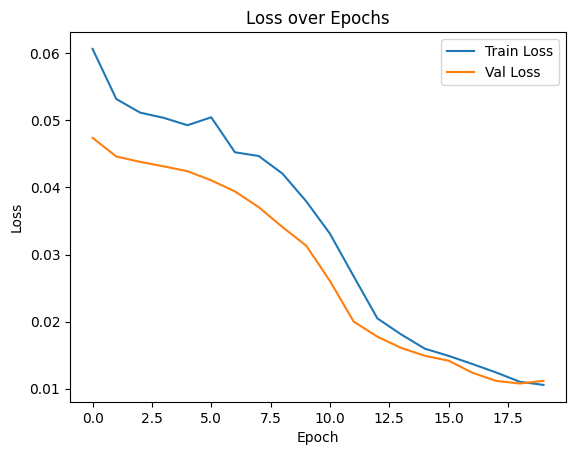

model saved in  /content/DATASET_EXXA

 ###### FULL DATA SET VISUALISATIONS #######
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)


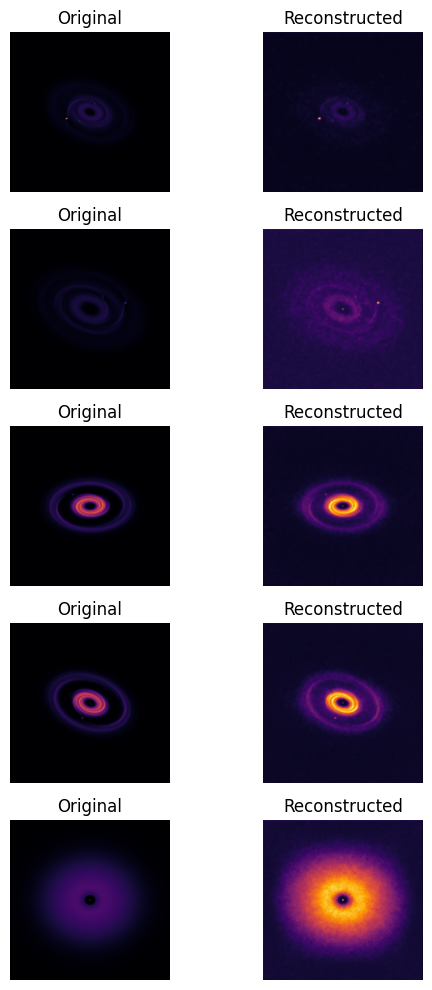

 ----------------------------END OF PIPELINE------------------------------


In [50]:
######### driver function ############

# first call the pipeline to train the model of your choice
full_pipeline(normalised, selected_channels=[0], model_choice='skipunet', latent_dim=128, num_epochs=20, lr=1e-4,to_viz=['full'])

# the invoke the process image
# NOTE , your image dims must be 3 , H x W x C , any one channel . You can also input H x W , it will be converted to H x W x 1
# process_image(your_image, trained_model)


# If you want to use a pretrained model from my repo
# model_path = "model_path"
# model = SkipUNet(in_channels=1, latent_dim=128)
# model.load_state_dict(torch.load(model_path, map_location='cpu'))
# model.eval()
# latent_vector, reconstructed_img = process_external_image(your_image, model)


 ----------------------------START OF PIPELINE------------------------------
Epoch 1/20 | Train Loss: 0.2922 | Val Loss: 0.2908
Epoch 2/20 | Train Loss: 0.2721 | Val Loss: 0.2513
Epoch 3/20 | Train Loss: 0.2142 | Val Loss: 0.1716
Epoch 4/20 | Train Loss: 0.1448 | Val Loss: 0.1216
Epoch 5/20 | Train Loss: 0.1049 | Val Loss: 0.0897
Epoch 6/20 | Train Loss: 0.0802 | Val Loss: 0.0676
Epoch 7/20 | Train Loss: 0.0639 | Val Loss: 0.0529
Epoch 8/20 | Train Loss: 0.0518 | Val Loss: 0.0448
Epoch 9/20 | Train Loss: 0.0449 | Val Loss: 0.0392
Epoch 10/20 | Train Loss: 0.0407 | Val Loss: 0.0380
Epoch 11/20 | Train Loss: 0.0374 | Val Loss: 0.0361
Epoch 12/20 | Train Loss: 0.0360 | Val Loss: 0.0345
Epoch 13/20 | Train Loss: 0.0353 | Val Loss: 0.0324
Epoch 14/20 | Train Loss: 0.0326 | Val Loss: 0.0315
Epoch 15/20 | Train Loss: 0.0302 | Val Loss: 0.0293
Epoch 16/20 | Train Loss: 0.0304 | Val Loss: 0.0288
Epoch 17/20 | Train Loss: 0.0292 | Val Loss: 0.0278
Epoch 18/20 | Train Loss: 0.0271 | Val Loss: 0.0

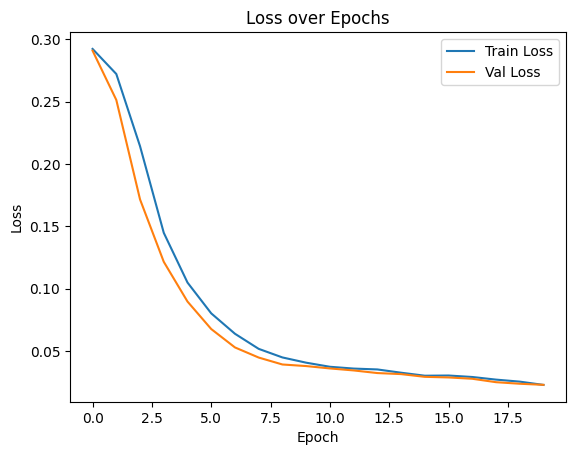

model saved in  /content/DATASET_EXXA

 ###### FULL DATA SET VISUALISATIONS #######
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)


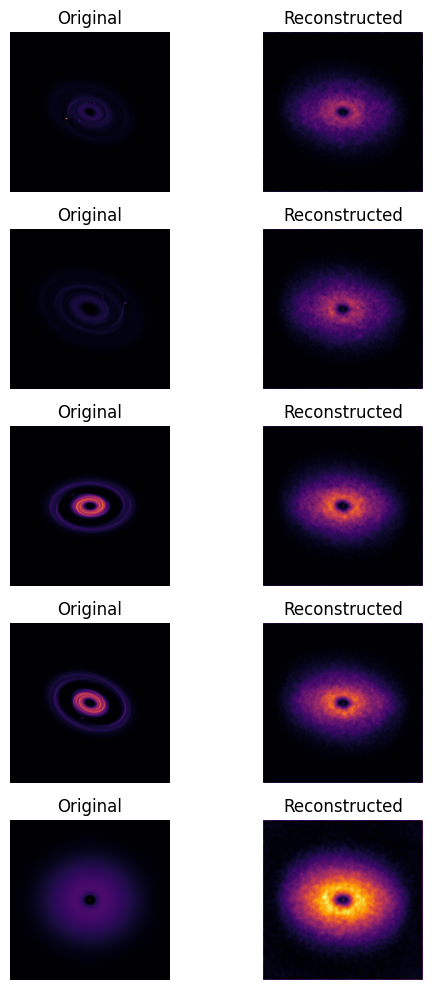

 ----------------------------END OF PIPELINE------------------------------


In [51]:
full_pipeline(normalised, selected_channels=[0], model_choice='vae', latent_dim=128, num_epochs=20, lr=1e-4,to_viz=['full'])


 ----------------------------START OF PIPELINE------------------------------


Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:06<00:00, 40.2MB/s]


Epoch 1/20 | Train Loss: 0.0617 | Val Loss: 0.0575
Epoch 2/20 | Train Loss: 0.0612 | Val Loss: 0.0608
Epoch 3/20 | Train Loss: 0.0627 | Val Loss: 0.0562
Epoch 4/20 | Train Loss: 0.0530 | Val Loss: 0.0432
Epoch 5/20 | Train Loss: 0.0462 | Val Loss: 0.0420
Epoch 6/20 | Train Loss: 0.0465 | Val Loss: 0.0469
Epoch 7/20 | Train Loss: 0.0468 | Val Loss: 0.0417
Epoch 8/20 | Train Loss: 0.0446 | Val Loss: 0.0396
Epoch 9/20 | Train Loss: 0.0407 | Val Loss: 0.0373
Epoch 10/20 | Train Loss: 0.0401 | Val Loss: 0.0360
Epoch 11/20 | Train Loss: 0.0418 | Val Loss: 0.0346
Epoch 12/20 | Train Loss: 0.0380 | Val Loss: 0.0379
Epoch 13/20 | Train Loss: 0.0353 | Val Loss: 0.0300
Epoch 14/20 | Train Loss: 0.0269 | Val Loss: 0.0258
Epoch 15/20 | Train Loss: 0.0231 | Val Loss: 0.0215
Epoch 16/20 | Train Loss: 0.0189 | Val Loss: 0.0199
Epoch 17/20 | Train Loss: 0.0172 | Val Loss: 0.0169
Epoch 18/20 | Train Loss: 0.0160 | Val Loss: 0.0166
Epoch 19/20 | Train Loss: 0.0149 | Val Loss: 0.0161
Epoch 20/20 | Train L

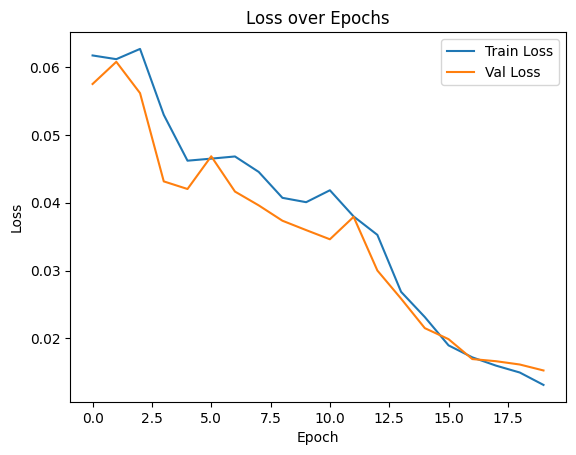

model saved in  /content/DATASET_EXXA

 ###### FULL DATA SET VISUALISATIONS #######
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)
origial shaoe (1, 600, 600)
reconstructions shape (1, 600, 600)


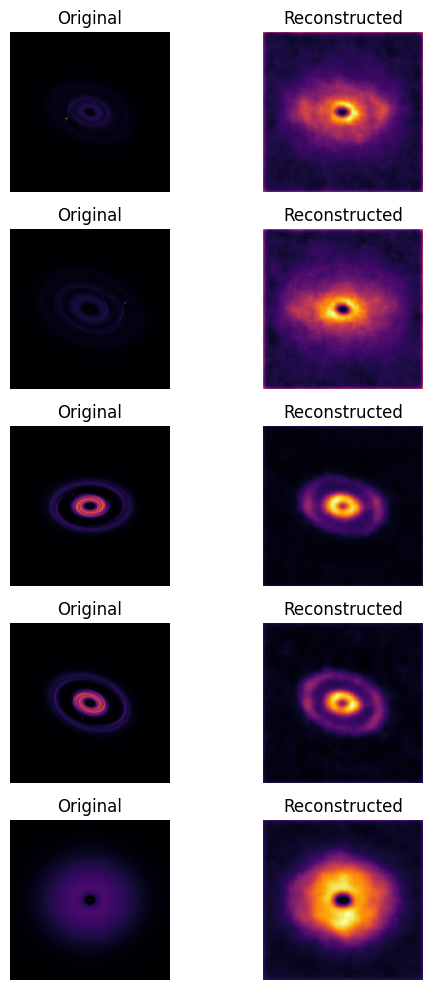

 ----------------------------END OF PIPELINE------------------------------


In [52]:
full_pipeline(normalised, selected_channels=[0], model_choice='alexnet', latent_dim=128, num_epochs=20, lr=1e-4,to_viz=['full'])


**Observations : **

The reconstructed images are smooth,rings are well-preserved and slightly more intensified

The blobs( planets)  are preserved, though slightly bloated

Background is slightly brighter; some noise amplification is present

Reconstructed spiral is smoother but a little broader

Faint ring edges more prominently than in original

